# Computer Vision Project
#### Introduction to Machine learning course | Instructor: Dr. Fatemeh Mirsalehi

<font color='cyan'> Responsible TA: Amirhossein Razlighi </font>

In [ ]:
%pip install torch torchvision numpy matplotlib Pillow

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt

## Section 1: Implementing a CNN from scratch! (30 points)

### 1.1 - Forward and Backward (20/30 pts)

__CNN__ s are powerfull tools to work with in the scope of _Computer Vision_. You have seen MLPs before and know how to do forward and backward pass on them. In this part, we want to create a convolutional layer (a simple one, of course!) just to understand well that how a Convolutional Layer works, behind the scenes. Then, we can simply use PyTorch's `Conv2D` layer for the rest of this project, because we understood that how Convolutions work, behind the scene!

__FORWARD PASS__:

In forward pass, you should apply the convolution operation on the input image. The convolution operation is as follows:

$$
\text{output}[i, j] = \sum_{k=0}^{K-1} \sum_{l=0}^{L-1} \text{input}[i+k, j+l] \times \text{kernel}[k, l]
$$

You can see a sample convolution operation (with a $3 \times 3$ kernel) in the following image:
<div style="text-align:center;">
  <img src="./Images/Conv.gif" />
</div>

Please note that, these are samples for you to understand the operation better. For _forward pass_ that you should implement, please notice that you should convolve the kernel along all $C$ channels of the input image. So, the output shape should be $(N, H_{out}, W_{out})$. These values are calculated as follows:

$$
H_{out} = \frac{H_{in} + 2 \times \text{padding}}{\text{stride} - HH} + 1
$$
$$
W_{out} = \frac{W_{in} + 2 \times \text{padding}}{\text{stride} - WW} + 1
$$


where $HH$ and $WW$ are the height and width of the kernel, respectively. __stride__ is the step size of the kernel, and __padding__ is the number of zeros that should be padded to the input image. Please also note that $b$ stands for bias, which is a scalar value that should be added to the output of the convolution operation. (for each kernel)

You can see a more detailed example, below:

<div style="text-align:center;">
  <img src="./Images/conv3.gif" />
</div>

__Backward Pass__:

In backward pass, you should calculate gradient of output with respect to the input image and the kernel. These gradients will be used in _optimization_ to update kernel weights. (You saw something similar, in using MLPs with gradient descent algorithm!). So, we need $d_x$, $d_w$ and $d_b$ in the backward pass. These are calculated as follows:

$$
dx_{padded} [n, :, i * stride: i * stride + HH, j * stride: j * stride + WW] += w[f] \times dout[n, f, i, j]
$$

$$
dw_{f} = \sum_{n=0}^{N - 1} \sum_{i=0}^{H_{out} - 1} \sum_{j=0}^{W_{out} - 1} x_{padded}[n, :, i * stride: i * stride + HH, j * stride: j * stride + WW] \times dout[n, f, i, j]  
$$

$$
db_{f} = \sum_{n=0}^{N - 1} \sum_{i=0}^{H_{out} - 1} \sum_{j=0}^{W_{out} - 1} dout[n, f, i, j]
$$

For better understanding of the backward pass, you can see the following image:

<div style="text-align:center;">
  <img src="./Images/backprop_cs231n.png" />
</div>


In [ ]:
import numpy as np

class MyConv:
    def __init__(self, stride, padding):
        self.stride = stride
        self.padding = padding

    def forward(self, x, w, b):
        N, C, H, W = x.shape
        F, _, HH, WW = w.shape
        pad = self.padding
        stride = self.stride

        H_out = (H + 2 * pad - HH) // stride + 1
        W_out = (W + 2 * pad - WW) // stride + 1

        x_pad = np.pad(x, ((0, 0), (0, 0), (pad, pad), (pad, pad)), mode='constant')
        out = np.zeros((N, F, H_out, W_out))

        for n in range(N):
            for f in range(F):
                for k in range(H_out):
                    for l in range(W_out):
                        out[n, f, k, l] = np.sum(
                            x_pad[n, :, k * stride:k * stride + HH, l * stride:l * stride + WW] * w[f]
                        ) + b[f]

        cache = (x, w, b, x_pad)
        self.cache = cache
        return out

    def backward(self, dout):
        x, w, b, x_padded = self.cache
        N, C, H, W = x.shape
        F, _, HH, WW = w.shape
        _, _, H_out, W_out = dout.shape
        dw = np.zeros_like(w)
        db = np.zeros_like(b)
        dx_padded = np.zeros_like(x_padded)
        for n in range(N):
            for f in range(F):
                for i in range(H_out):
                    for j in range(W_out):
                        dw[f] += x_padded[n, :, i * self.stride:i * self.stride + HH, j * self.stride:j * self.stride + WW] * dout[n, f, i, j]
                        dx_padded[n, :, i * self.stride:i * self.stride + HH, j * self.stride:j * self.stride + WW] += w[f] * dout[n, f, i, j]
                        db[f] += dout[n, f, i, j]
        if self.padding != 0:
            dx = dx_padded[:, :, self.padding:-self.padding, self.padding:-self.padding]
        else:
            dx = dx_padded
        self.dx = dx
        self.dw = dw
        self.db = db
        return dx, dw, db


In [ ]:
def rel_error(x, y):
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

In [ ]:
# A simple test for forward pass (DO NOT CHANGE)

x_shape = (2, 3, 4, 4)
w_shape = (3, 3, 4, 4)
x = np.linspace(-0.1, 0.5, num=np.prod(x_shape)).reshape(x_shape)
w = np.linspace(-0.2, 0.3, num=np.prod(w_shape)).reshape(w_shape)
b = np.linspace(-0.1, 0.2, num=3)

out = MyConv(stride=2, padding=1).forward(x, w, b)
correct_out = np.array([[[[[-0.08759809, -0.10987781],
                           [-0.18387192, -0.2109216 ]],
                          [[ 0.21027089,  0.21661097],
                           [ 0.22847626,  0.23004637]],
                          [[ 0.50813986,  0.54309974],
                           [ 0.64082444,  0.67101435]]],
                         [[[-0.98053589, -1.03143541],
                           [-1.19128892, -1.24695841]],
                          [[ 0.69108355,  0.66880383],
                           [ 0.59480972,  0.56776003]],
                          [[ 2.36270298,  2.36904306],
                           [ 2.38090835,  2.38247847]]]]])

# The outputted difference which is printed, should be around 1e-8
print ('Testing conv_forward_naive')
print ('difference: ', rel_error(out, correct_out))

Testing conv_forward_naive
difference:  2.2121476417505994e-08


In [ ]:
def eval_numerical_gradient_array(f, x, df, h=1e-5):
  grad = np.zeros_like(x)
  it = np.nditer(x, flags=['multi_index'], op_flags=['readwrite'])
  while not it.finished:
    ix = it.multi_index

    oldval = x[ix]
    x[ix] = oldval + h
    pos = f(x).copy()
    x[ix] = oldval - h
    neg = f(x).copy()
    x[ix] = oldval

    grad[ix] = np.sum((pos - neg) * df) / (2 * h)
    it.iternext()
  return grad

In [ ]:
# A simple test for backward pass (DO NOT CHANGE)

x = np.random.randn(4, 3, 5, 5)
w = np.random.randn(2, 3, 3, 3)
b = np.random.randn(
    2,
)
dout = np.random.randn(4, 2, 5, 5)
conv = MyConv(stride=1, padding=1)

dx_num = eval_numerical_gradient_array(
    lambda x: conv.forward(x, w, b), x, dout
)
dw_num = eval_numerical_gradient_array(
    lambda w: conv.forward(x, w, b), w, dout
)
db_num = eval_numerical_gradient_array(
    lambda b: conv.forward(x, w, b), b, dout
)

out = conv.forward(x, w, b)
dx, dw, db = conv.backward(dout)

# Your printed errors should be around 1e-9
print("Testing conv_backward_naive function")
print("dx error: ", rel_error(dx, dx_num))
print("dw error: ", rel_error(dw, dw_num))
print("db error: ", rel_error(db, db_num))

Testing conv_backward_naive function
dx error:  3.2400858380148792e-09
dw error:  1.212102393613176e-10
db error:  1.4504875613176147e-11


### 1.2 - Visualizing Convolution results (10/30 pts)

In this part, we try to visualize the results of the convolution operation. We will 2 sample photos (in `Images/Sample`) and then we will use our `MyConv` class to apply some cool convolutions (and see their result on an image).

In [ ]:
from PIL import Image

first_img, second_img = Image.open("/content/Sharif_1.JPG"), Image.open(
    "/content/Sharif_2.jpg"
)
first_img = first_img.resize((256, 256))
second_img = second_img.resize((256, 256))

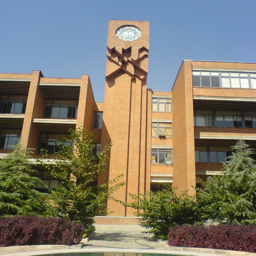

In [ ]:
first_img

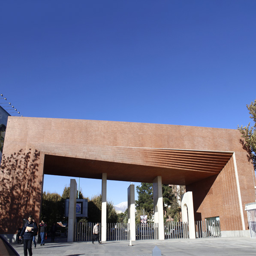

In [ ]:
second_img

Convolutions have some interesting usages in image processing. For example, you can extract edges from an image by applying a convolution with a kernel that detects edges. Or you can convolve a specific kernel with your image to make it grayscale or blurred! Look at the definitions below:

__Edge Detection Kernel__:

_Sobel_ is one of the most famous edge detection kernels. It has two kernels, one for detecting vertical edges and the other for horizontal edges. You can see the kernels below:
$$
\text{Sobel}_x = \begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{bmatrix}
$$

$$
\text{Sobel}_y = \begin{bmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1
\end{bmatrix}
$$


__Grayscale Kernel__:

You can simply convolve the image with the following kernel to make it grayscale:

$$
\text{Grayscale\_across\_R} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.3 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

$$
\text{Grayscale\_across\_G} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.6 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

$$
\text{Grayscale\_across\_B} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.1 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

(Convolve each kernel with its corresponding channel)

__Blurring Kernel__:

One of the famous kernels to blur an image is _Gaussian Blur_. You can see the kernel below:

$$
\text{Gaussian\_Blur} = \frac{1}{16} \times \begin{bmatrix}
1 & 2 & 1 \\
2 & 4 & 2 \\
1 & 2 & 1
\end{bmatrix}
$$


In [ ]:
img_size = 256

x = np.zeros((2, 3, img_size, img_size))
x[0] = np.array(first_img).transpose(2, 0, 1)
x[1] = np.array(second_img).transpose(2, 0, 1)

sobel_x = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
sobel_y = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
grayscale_kernel_r = np.array([[0, 0, 0], [0, 0.3, 0], [0, 0, 0]])
grayscale_kernel_g = np.array([[0, 0, 0], [0, 0.6, 0], [0, 0, 0]])
grayscale_kernel_b = np.array([[0, 0, 0], [0, 0.1, 0], [0, 0, 0]])
gaussian_blur = np.array([[1, 2, 1], [2, 4, 2], [1, 2, 1]]) / 16
w = np.stack([grayscale_kernel_r, grayscale_kernel_g, grayscale_kernel_b, sobel_x, sobel_y, gaussian_blur])
w = np.repeat(w[:, np.newaxis, :, :], 3, axis=1)


b = np.array([0, 0, 0, 0, 0, 0])

conv = MyConv(stride=1, padding=1)
out = conv.forward(x, w, b)
grayscale_images = np.sum(out[:, :3], axis=1)

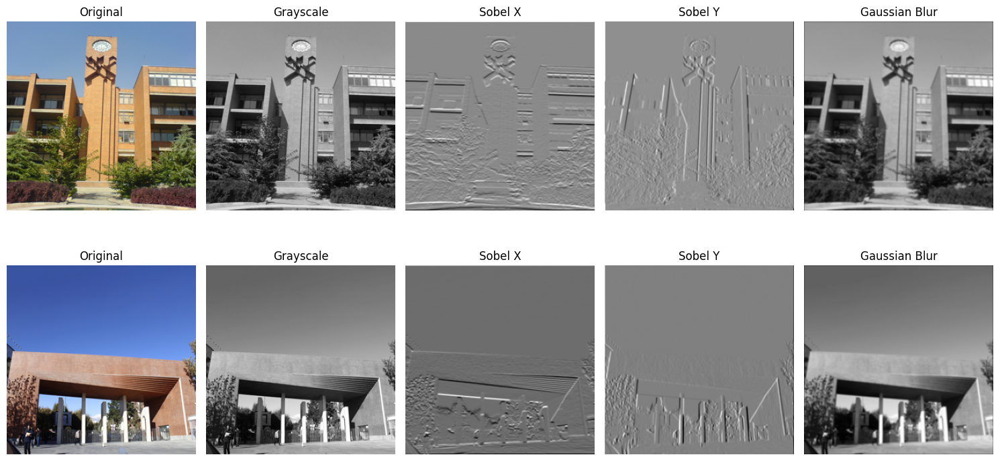

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(15, 8))

titles = ['Original', 'Grayscale', 'Sobel X', 'Sobel Y', 'Gaussian Blur']

for i in range(2):
    axes[i, 0].imshow(np.array(first_img) if i == 0 else np.array(second_img))
    axes[i, 0].set_title(f'{titles[0]}')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(grayscale_images[i], cmap='gray')
    axes[i, 1].set_title(f'{titles[1]}')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(out[i, 3], cmap='gray')
    axes[i, 2].set_title(f'{titles[2]}')
    axes[i, 2].axis('off')

    axes[i, 3].imshow(out[i, 4], cmap='gray')
    axes[i, 3].set_title(f'{titles[3]}')
    axes[i, 3].axis('off')

    axes[i, 4].imshow(out[i, 5], cmap='gray')
    axes[i, 4].set_title(f'{titles[4]}')
    axes[i, 4].axis('off')

plt.tight_layout()
plt.show()

Now that we understood how Convolution works, we proceed further to use it in our models to perform a desired and specific task! We can use PyTorch's `Conv2D` layer from now on, because we understood how Convolutions work, behind the scene!

## Section 2: Neural Style Transfer (90 points)

In this part, we are going to implement a famous technique in the field of _Computer Vision_ called __Neural Style Transfer__. This technique is used to apply the style of a specific image to another image. For example, you can apply the style of a famous painting to your photo! Let's get started!

### 2.1 - Importing Libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights

import copy

In [ ]:
device = torch.device(
    "cuda"
    if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_available() else "cpu"
)
torch.set_default_device(device)
device

device(type='cpu')

### 2.2 - Loading Images and doing some Preprocessing (5/90 pts)

In this part, you should load the content and style images and preprocess them. Preprocessing includes resizing the images to a specific size, normalizing them, and converting them to PyTorch tensors. You can use `torchvision.transforms` to do these tasks.

In [ ]:
img_size = 512 if not device == "cpu" else 256

transform = transforms.Compose([
    transforms.Resize((img_size, img_size)),
    transforms.ToTensor(),
])

In [ ]:
style_image = Image.open("/content/style.jpeg") # It's in Images/Neural_Transfer/Style.jpeg
content_image = Image.open("/content/Content.jpeg") # It's in Images/Neural_Transfer/Content.jpeg
style_image = transform(style_image).unsqueeze(0).to(device)
content_image = transform(content_image).unsqueeze(0).to(device)
style_image.size(), content_image.size()

(torch.Size([1, 3, 512, 512]), torch.Size([1, 3, 512, 512]))

Here, you should implement a helper function to show you images (which are now in form of pytorch tensors) in the notebook. You can use `torchvision.transforms.ToPILImage` to convert a tensor to a PIL image.

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.pause(0.001)

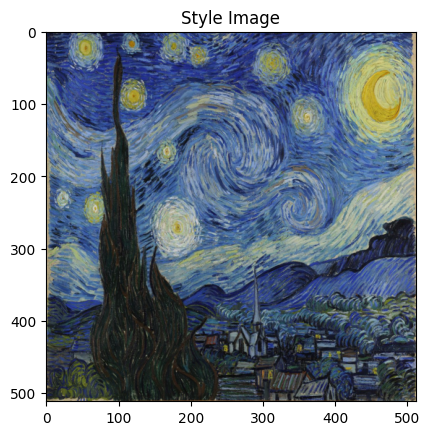

In [ ]:
imshow(style_image, "Style Image")

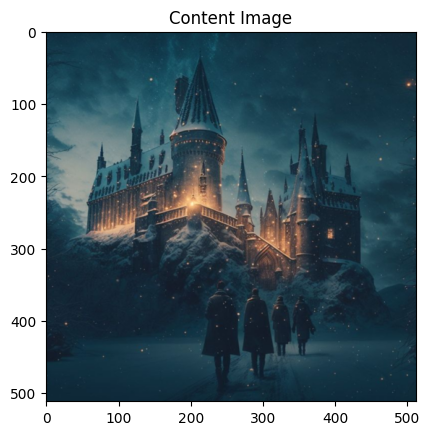

In [ ]:
imshow(content_image, "Content Image")


### 2.2 - VGG19 Model (15/90 pts)

One of the important parts of Neural Style Transfer is to use a pre-trained model to extract features from the content and style images. Here, we are going to use a pre-trained VGG19 model to extract features from the images. You can use `torchvision.models.vgg19` to load the model. You should also freeze the weights of the model to prevent them from updating during the optimization process.

<div style="text-align:center;">
  <img src="./Images/VGG-19.png" />
</div>

But what is VGG model? Let's see with a simple experiment:

In [ ]:
import certifi
import os

os.environ['SSL_CERT_FILE'] = certifi.where()

Here, please load `VGG19` model from `torchvision.models` and see the architecture of the model. You may need models `features` and `classifier` part stored seperately as we will discuss these both parts.

In [ ]:
vgg_model = vgg19(pretrained=True)
vgg_model_features = vgg_model.features
vgg_model_classifier = vgg_model.classifier

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 77.5MB/s]


In [ ]:
import torchsummary
torchsummary.summary(vgg_model, input_size=(3, 512, 512))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 512, 512]           1,792
              ReLU-2         [-1, 64, 512, 512]               0
            Conv2d-3         [-1, 64, 512, 512]          36,928
              ReLU-4         [-1, 64, 512, 512]               0
         MaxPool2d-5         [-1, 64, 256, 256]               0
            Conv2d-6        [-1, 128, 256, 256]          73,856
              ReLU-7        [-1, 128, 256, 256]               0
            Conv2d-8        [-1, 128, 256, 256]         147,584
              ReLU-9        [-1, 128, 256, 256]               0
        MaxPool2d-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 256, 128, 128]         295,168
             ReLU-12        [-1, 256, 128, 128]               0
           Conv2d-13        [-1, 256, 128, 128]         590,080
             ReLU-14        [-1, 256, 1

Please briefly explain what is a VGG model used for and what does each `features` and `classifier` part, represent?

**Your Answer:**

The VGG model is primarily used for image classification tasks. It has been trained on a large dataset (ImageNet) and has achieved high accuracy on various benchmark tests. The features extracted by the convolutional layers can also be used for other computer vision tasks, such as object detection, segmentation, and neural style transfer.

now for the features and classifier parts:

Features:
Responsible for extracting features from the input image. These features include low-level features and high-level features in the deeper layers.

Classifier:
Takes the features extracted by the convolutional layers and uses them to classify the input image into different categories. This part includes fully connected layers that learn the mapping from features to class labels.

Now, we are going to give a sample image `Images/Neural_Transfer/Car.jpeg` to the model, see the output for classification and also visualize the feature maps (outputs of each convolutional layer) to see what's going on!

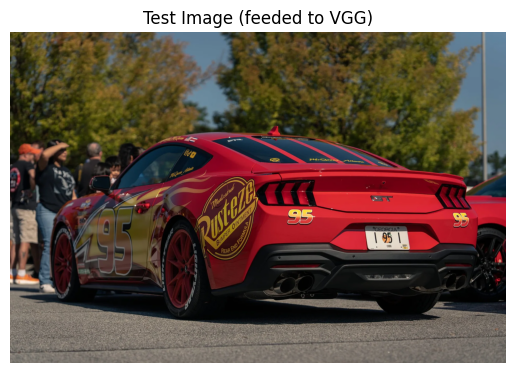

751


In [ ]:
import requests
vgg_test_image = Image.open("/content/Car.jpeg")

#TODO: Plot the image which we are feeding to the model
plt.imshow(vgg_test_image)
plt.title("Test Image (feeded to VGG)")
plt.axis('off')
plt.show()

preprocess_vgg = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
]) #TODO: required transformations for the input to the vgg model
input_tensor = preprocess_vgg(vgg_test_image)
input_batch = input_tensor.unsqueeze(0)
#TODO: Predict the output of the vgg model for the test image (final classifier output and also each feature map output (in Conv2D layers))
vgg_model.eval()
with torch.no_grad():
    output = vgg_model(input_batch)
    _, predicted = torch.max(output, 1)
print(predicted.item())

As you can see, the output of the classifier is an integer. This integer is actually the **class number** in _Image Net_ dataset. Let's get the name of the class:

In [ ]:
import requests

class_idx = requests.get(
    "https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json"
).json()

# Get the class name
class_name = class_idx[predicted.item()]

print(f"Predicted class: {class_name}")

Predicted class: race car


Now that we understood the architecture of VGG, and also the output of its classifier, it's time to extract features from the images! And see what's going on in the feature maps!

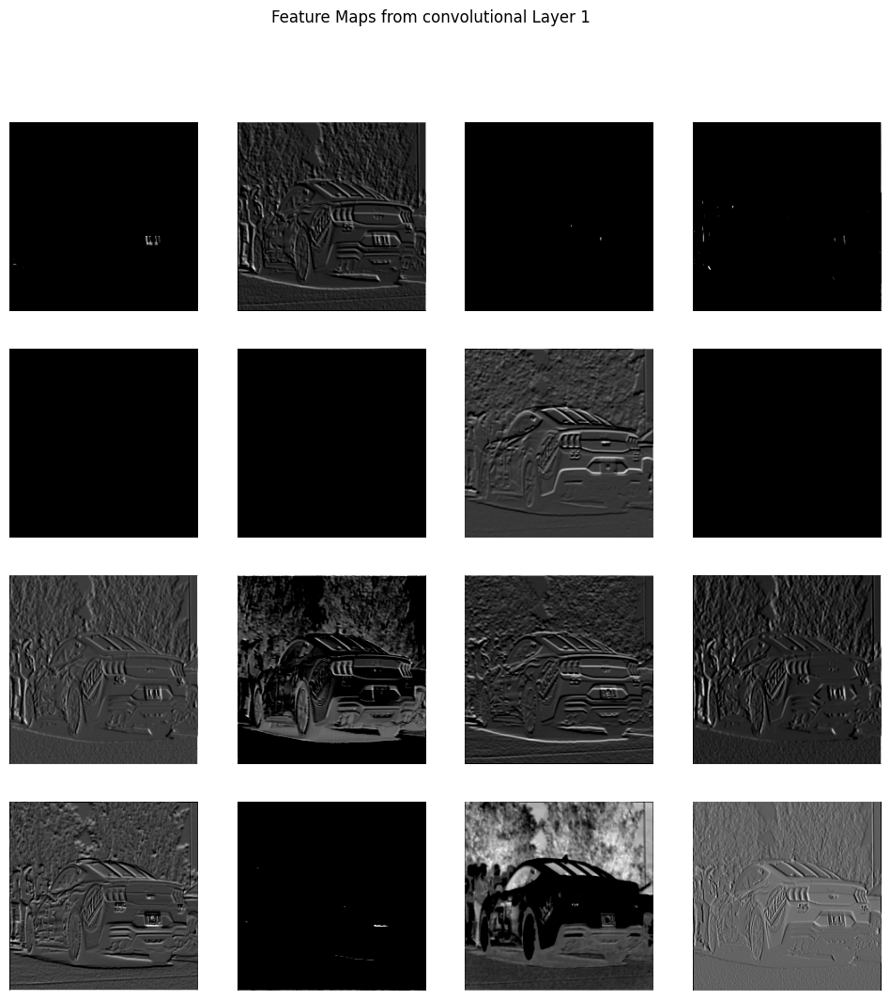

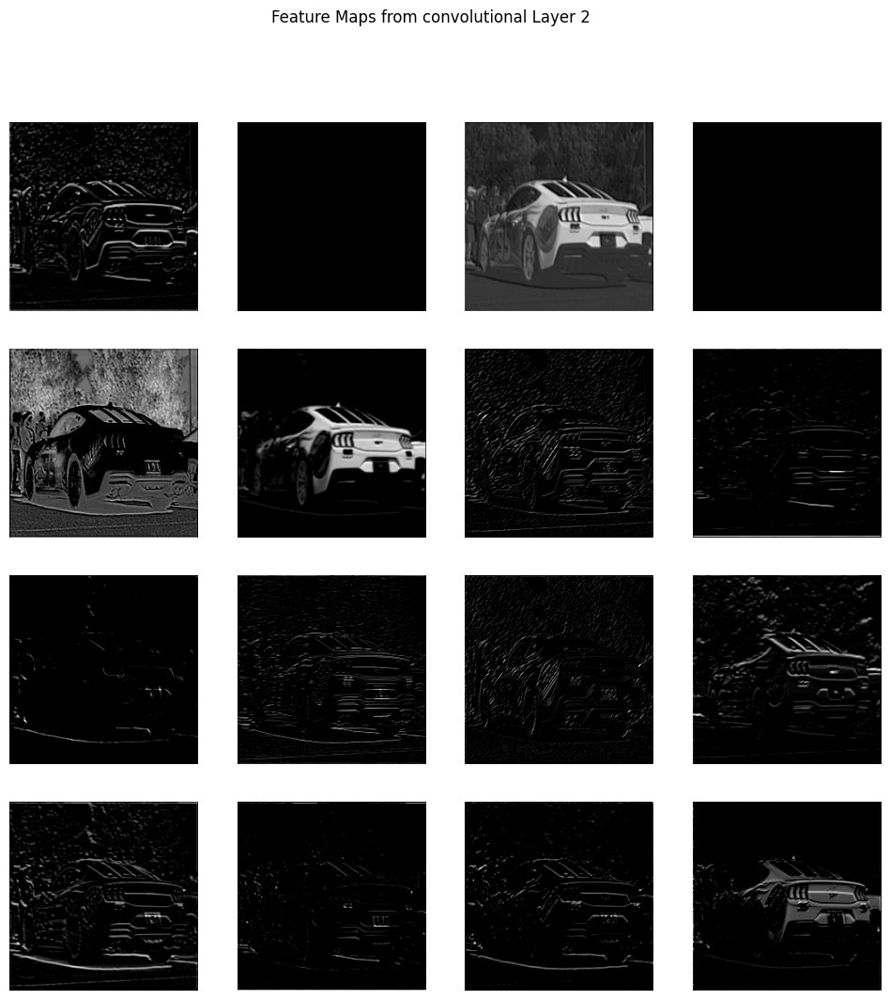

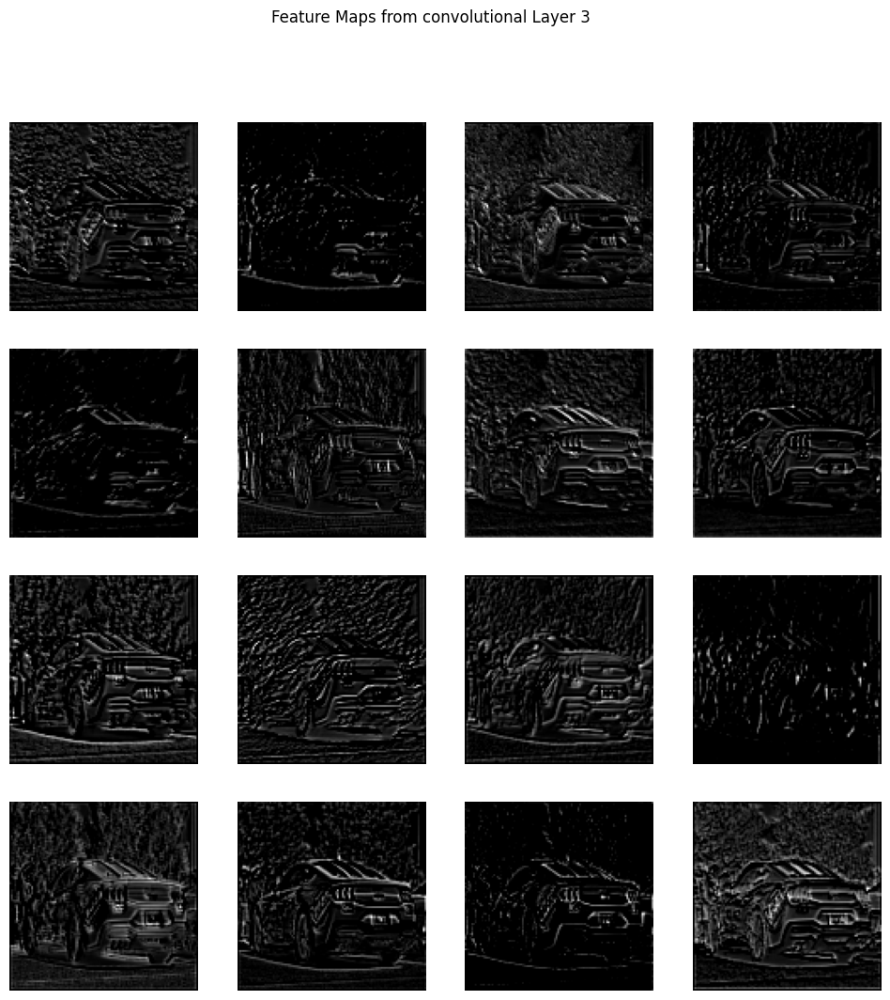

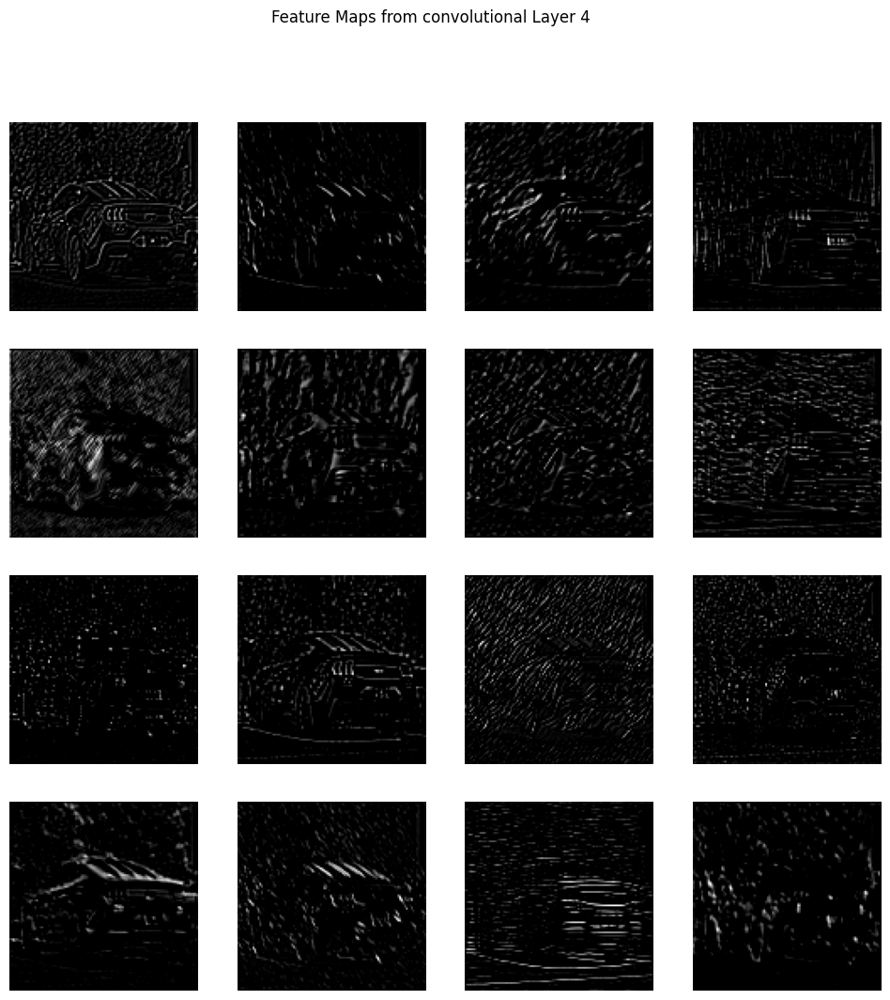

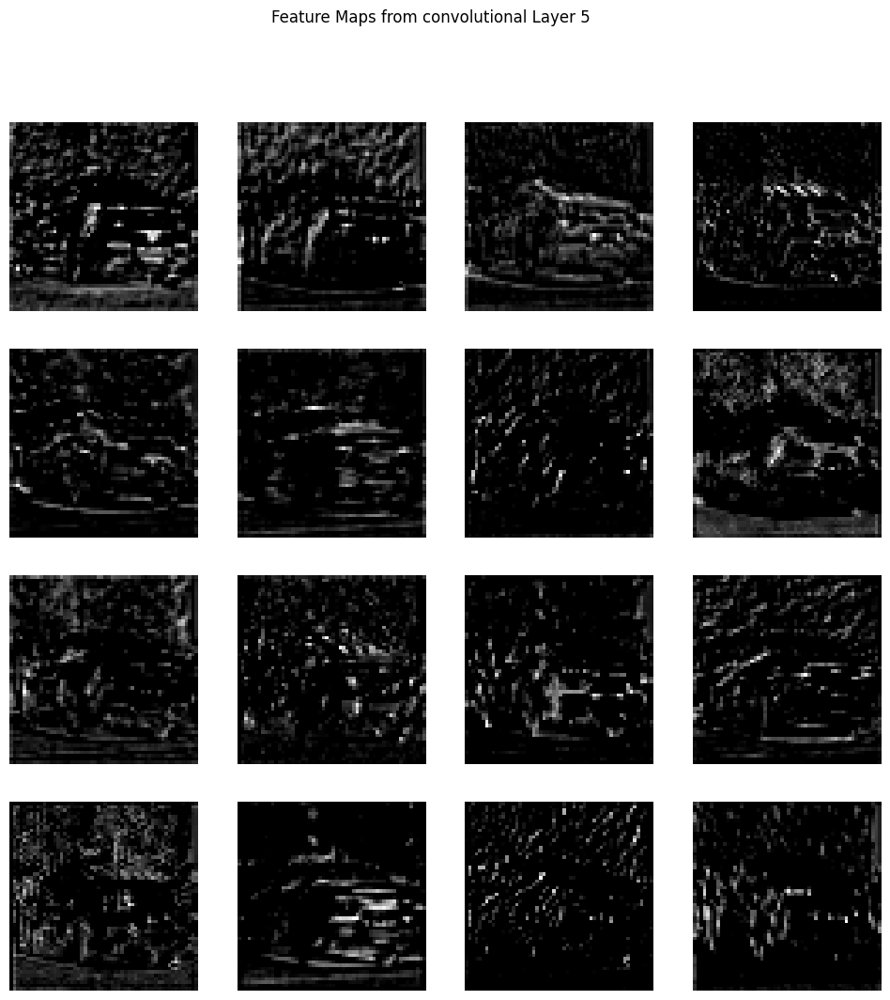

...

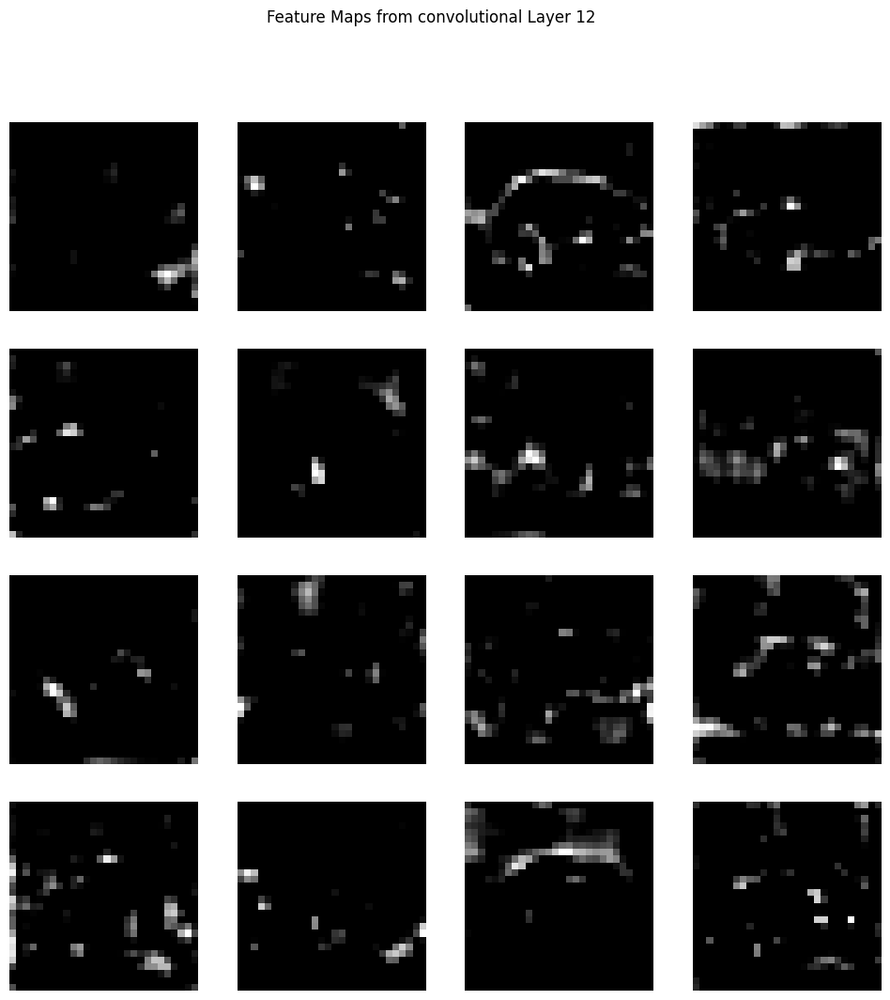

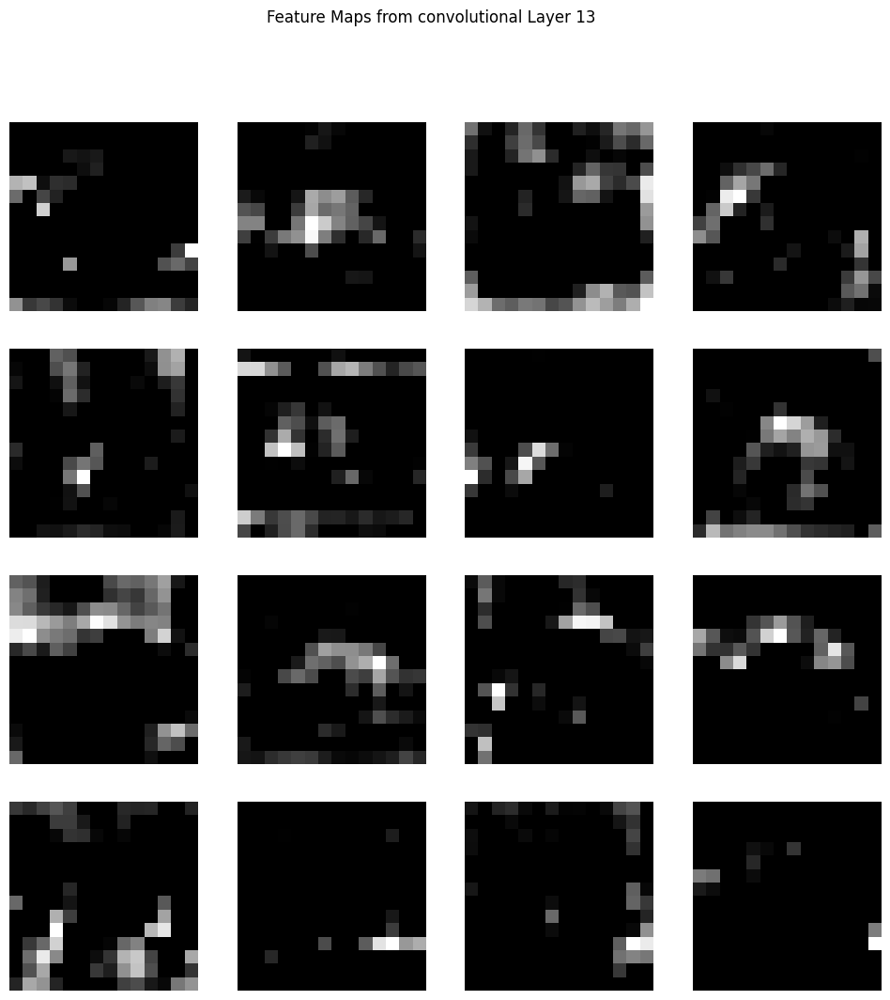

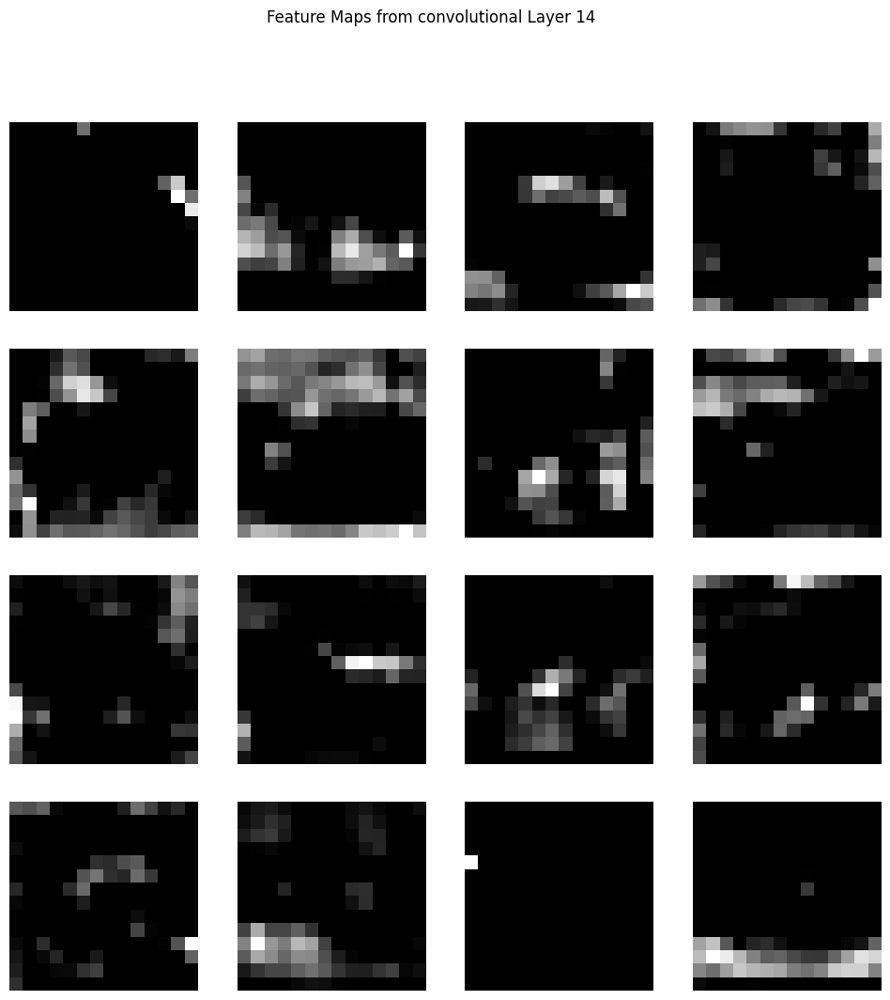

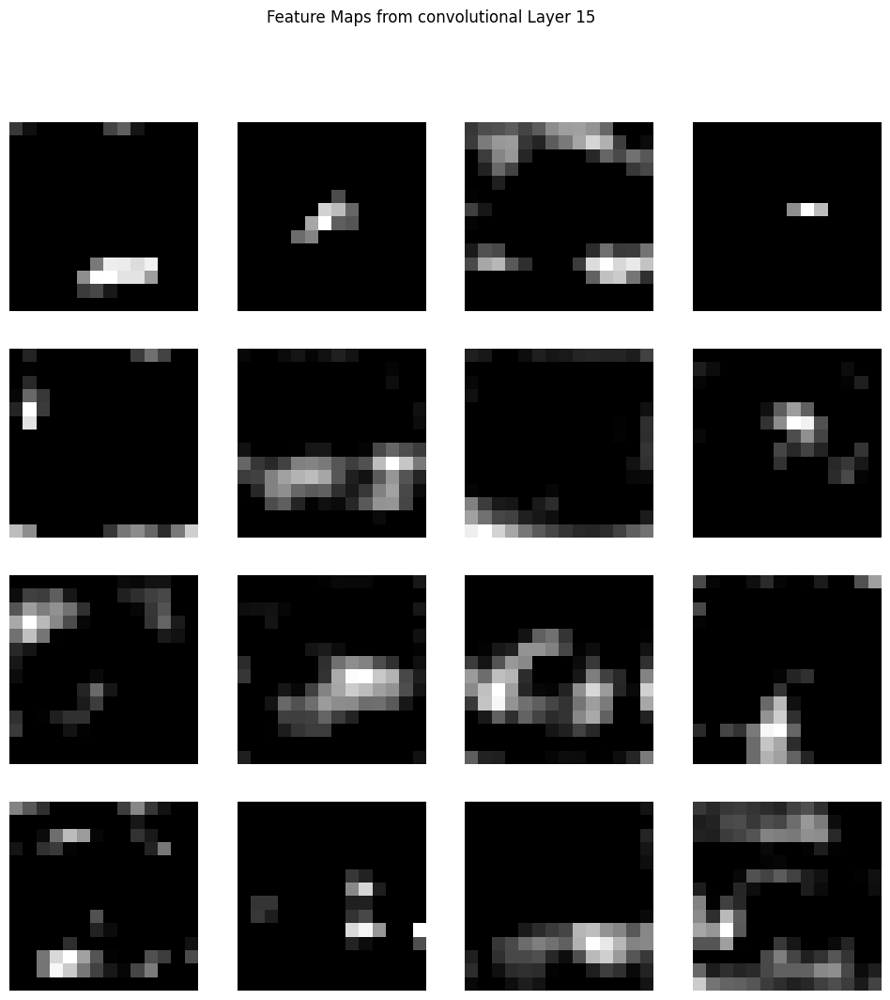

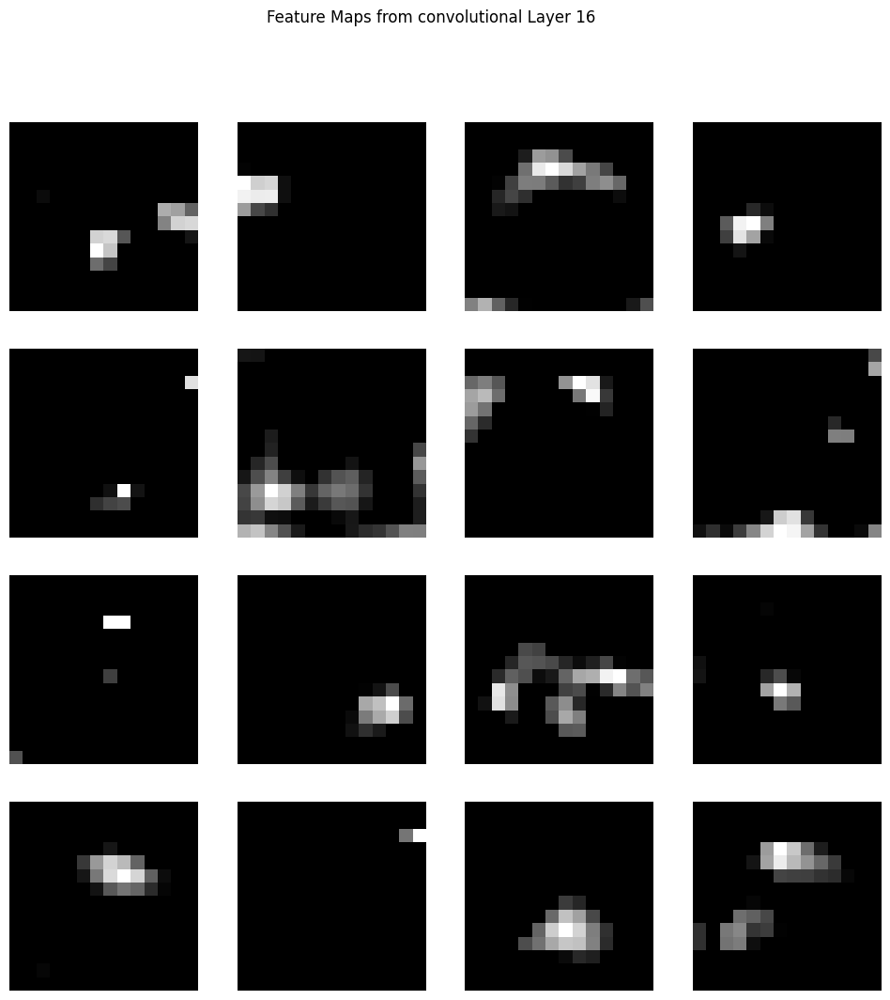

In [ ]:
# Visualize the first 16 feature maps of each Conv2D layer (there are 16 Conv2D layers in VGG19)
#TODO
def get_feature_maps(model, input):
    feature_maps = []
    x = input
    for layer in model.features:
        x = layer(x)
        if isinstance(layer, torch.nn.Conv2d):
            feature_maps.append(x)
    return feature_maps
feature_maps = get_feature_maps(vgg_model, input_batch)
for i, feature_map in enumerate(feature_maps):
    fig, axes = plt.subplots(4, 4, figsize=(12, 12))
    fig.suptitle(f"Feature Maps from convolutional Layer {i+1}")
    for j in range(16):
        axes[j // 4, j % 4].imshow(feature_map[0, j].cpu().detach(), cmap='gray')
        axes[j // 4, j % 4].axis('off')
    plt.show()

It's fun too look under the hood, isn't it? As you can see, we can guess what are the learned features in each layer if the network (at least in the first layers). For example, in the first layer, the network learns to detect edges, and in the second layer, it learns to detect simple shapes. In the deeper layers, the network learns to detect more complex features.

### 2.3 - Content and Style Loss (15/90 pts)

In order to learn the correct image and keep the content of the original image while applying the style of the seconf image, we need 2 losses: 1. Content Loss and 2. Style Loss. Let's delve into each one!

**Content Loss** is responsible for keeping the content of the original image. It is calculated as the mean squared error between the feature maps of the original image and the generated image.

In [ ]:
import torch
import torch.nn as nn
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.loss = 0
        self.target = target.detach()

    def forward(self, input):
        self.loss = nn.functional.mse_loss(input, self.target)
        return input

**Style Loss** is responsible for applying the style of the second image to the generated image. It is calculated as the mean squared error between the Gram matrices of the feature maps of the second image and the generated image.

In [ ]:
def gram_calculator(input):
    """
    Calculate the normalized Gram Matrix of a given input
    """
    a, b, c, d = input.size()
    features = input.view(a * b, c * d)
    return  torch.mm(features, features.t()).div(a * b * c * d)

In [ ]:
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.loss = 0
        self.target = gram_calculator(target_feature).detach()

    def forward(self, input):
        self.loss = nn.functional.mse_loss(gram_calculator(input), self.target)
        return input

Now, we use `features` part of the VGG model to extract features from the content and style images. Then, we calculate the content and style loss using the extracted features.

In [ ]:
import torchvision.models as models
import torchvision.transforms as transforms

cnn = models.vgg19(pretrained=True).features

In [ ]:
cnn_normalization_mean = torch.tensor(
    [0.485, 0.456, 0.406]
)  # Normalization mean for the VGG19 model
cnn_normalization_std = torch.tensor(
    [0.229, 0.224, 0.225]
)  # Normalization std for the VGG19 model
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.std = torch.tensor(std).view(-1, 1, 1).to(device)
        self.mean = torch.tensor(mean).view(-1, 1, 1).to(device)
    def forward(self, img):
        return (img - self.mean) / self.std

# Normalize the images in order to feed it to the VGG19 model


Please note that after which layers you should calculate the content loss and after which ones, you should calculate the style loss. Use the layer names you saw earlier in the `torchsummary` output for VGG19 model.

In [ ]:
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

#TODO: any processes you want to add and/or helper functions
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

/usr/local/lib/python3.10/dist-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


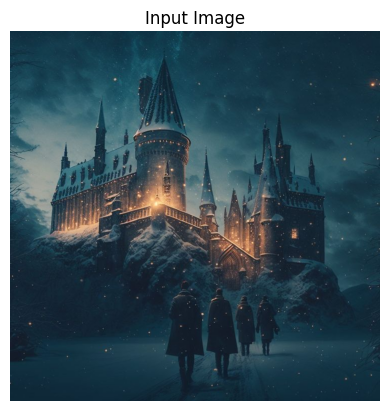

In [ ]:
import copy
import matplotlib.pyplot as plt
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input = Image.open("/content/Content.jpeg").convert('RGB')
input_tensor = transforms.ToTensor()(input).unsqueeze(0).to(device)
transform = transforms.Compose([
        transforms.Resize((200, 200)),
        transforms.ToTensor(),
    ])
image = Image.open('/content/Content.jpeg').convert('RGB')
image = transform(image).unsqueeze(0)
content_img = image.to(device)
image = Image.open('/content/style.jpeg').convert('RGB')
image = transform(image).unsqueeze(0)
style_img = image.to(device)
normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
style_losses = []
content_losses = []
model = nn.Sequential(normalization)
i = 0
for layer in cnn.children():
    if isinstance(layer, nn.Conv2d):
        i += 1
        name = 'conv_{}'.format(i)
    elif isinstance(layer, nn.ReLU):
        name = 'relu_{}'.format(i)
        layer = nn.ReLU(inplace=False)
    elif isinstance(layer, nn.MaxPool2d):
        name = 'pool_{}'.format(i)
    elif isinstance(layer, nn.BatchNorm2d):
        name = 'bn_{}'.format(i)
    else:
        raise RuntimeError('unexpected layer: {}'.format(layer.__class__.__name__))
    model.add_module(name, layer)
    if name in content_layers_default:
        target = model(content_img).detach()
        content_loss = ContentLoss(target)
        model.add_module("content_loss_{}".format(i), content_loss)
        content_losses.append(content_loss)

    if name in style_layers_default:
        target_feature = model(style_img).detach()
        style_loss = StyleLoss(target_feature)
        model.add_module("style_loss_{}".format(i), style_loss)
        style_losses.append(style_loss)
for i in range(len(model) - 1, -1, -1):
    if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
        break
model = model[:(i + 1)]
plt.figure()
plt.axis("off")
imshow(input_tensor, title='Input Image')
plt.show()


(15/90 pts) Now, we need to define our optimizer. We use `LBFGS` optimizer. Let's get familiar with this optimizer a little bit:

Let's use this optimizer to optimize a simple function $f(x) = x^2$. We want to find the minimum of this function using `LBFGS` optimizer. First, you should initialize a tensor $x$ with a random value. Then, you should define a closure function that calculates the value of the function and its gradient. Finally, you should use the `step` method of the optimizer to update the value of $x$.

And lastly, you should generate an animation using `matplotlib.animation` to show how the value of $x$ changes during optimization.

In [ ]:
import matplotlib.animation as animation
from torch.optim import LBFGS
import IPython.display as display
import matplotlib.pyplot as plt
def f(x):
    return x ** 2
x = torch.tensor([10.0], requires_grad=True)
optimizer = LBFGS([x], lr=0.15)
optimization_path = []
def optimization_step():
    optimizer.zero_grad()
    result = f(x)
    result.backward()
    optimization_path.append(x.item())
    return result
total_steps = 12
for _ in range(total_steps):
    optimizer.step(optimization_step)
fig, ax = plt.subplots()
line, = ax.plot([], [], 'bo', markersize=10)
x_range = torch.linspace(-10, 10, 100).detach().numpy()
y_range = f(x_range)
def init_plot():
    ax.plot(x_range, y_range, 'r-', label='f(x) = x^2')
    ax.set_ylim(0, 50)
    ax.set_xlim(-10, 10)
    ax.legend()
    return line,
def update_plot(frame):
    line.set_data(optimization_path[frame], f(torch.tensor(optimization_path[frame])))
    return line,
ani = animation.FuncAnimation(fig, update_plot, frames=len(optimization_path), init_func=init_plot, blit=True)
plt.xlabel('x')
plt.ylabel('f(x)')
plt.grid(True)
plt.close()
display.HTML(ani.to_jshtml())

<ipython-input-33-ffbf1a7fb138>:29: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(optimization_path[frame], f(torch.tensor(optimization_path[frame])))


(35/90 pts) Now, let's use this optimizer to optimize our `input_image` to minimize the content and style loss. You should define a closure function that calculates the content and style loss and their gradients. Then, you should use the `step` method of the optimizer to update the value of the `input_image`. Please also **note** that you should use a weighted sum of the content and style loss to optimize the input image. (weight of each loss is a hyperparameter)

0
content loss0.0
style loss8604.7216796875
total loss8604.7216796875


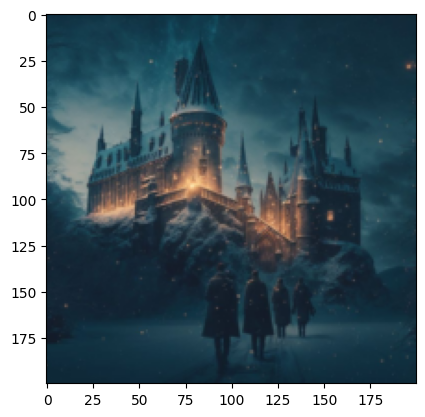

content loss4.279249665728457e-08
style loss8603.9775390625
total loss8603.9775390625


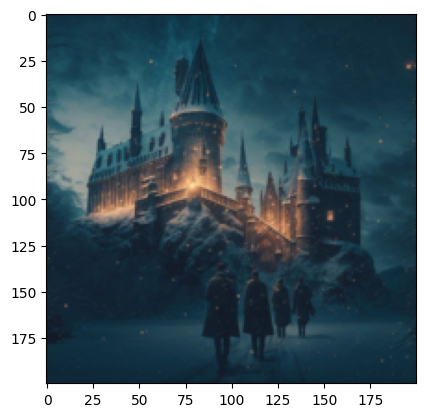

content loss1.631545901298523
style loss3994.685546875
total loss3996.317138671875


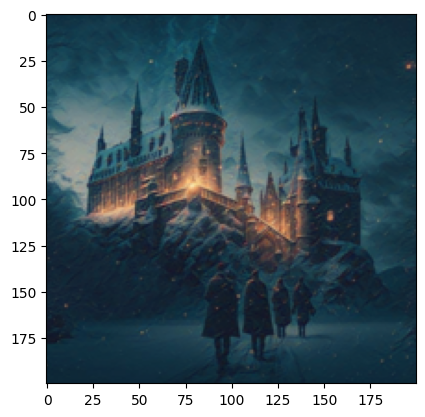

content loss2.1236414909362793
style loss3416.62158203125
total loss3418.7451171875


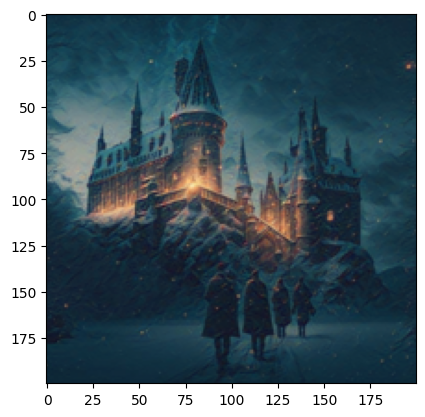

content loss2.4232685565948486
style loss3099.42333984375
total loss3101.8466796875


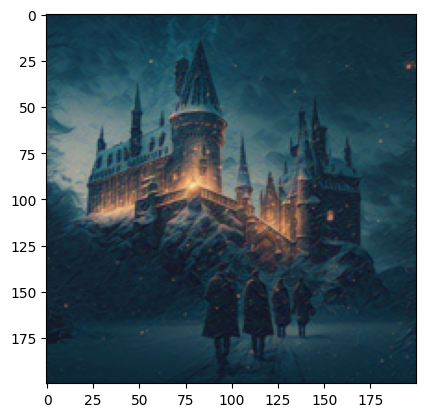

content loss2.838550567626953
style loss2727.945556640625
total loss2730.7841796875


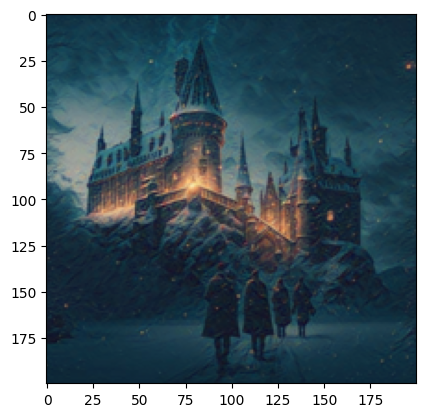

content loss3.2744946479797363
style loss2388.460205078125
total loss2391.734619140625


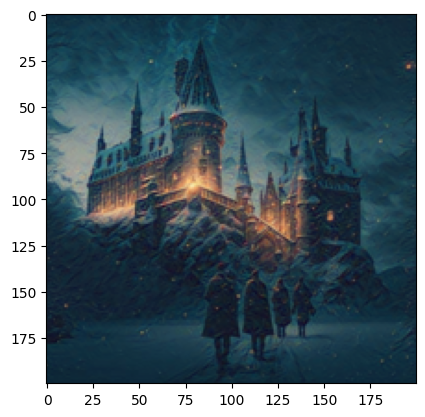

content loss3.7318480014801025
style loss2082.5146484375
total loss2086.24658203125


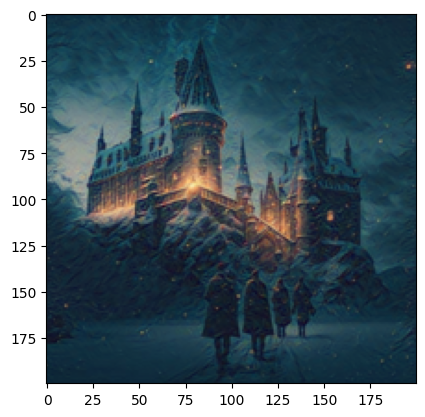

content loss4.175219535827637
style loss1825.95068359375
total loss1830.1258544921875


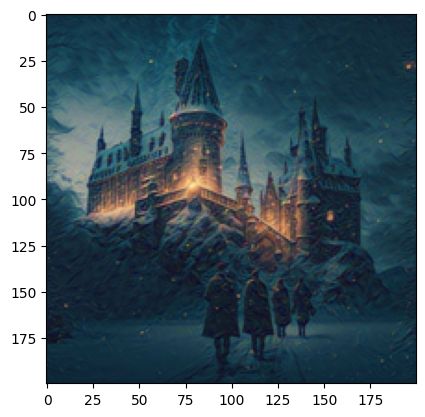

content loss4.588924407958984
style loss1619.171875
total loss1623.7607421875


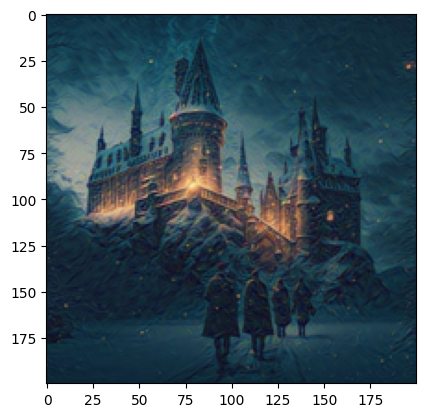

content loss4.960146903991699
style loss1457.1038818359375
total loss1462.0640869140625


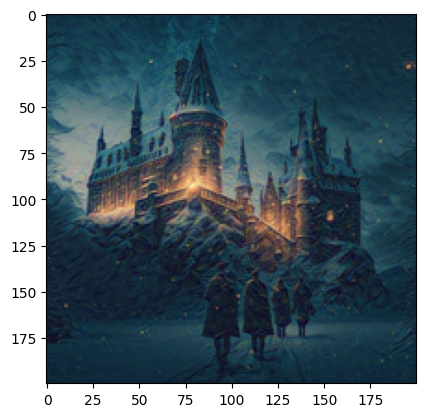

content loss5.283489227294922
style loss1331.917236328125
total loss1337.20068359375


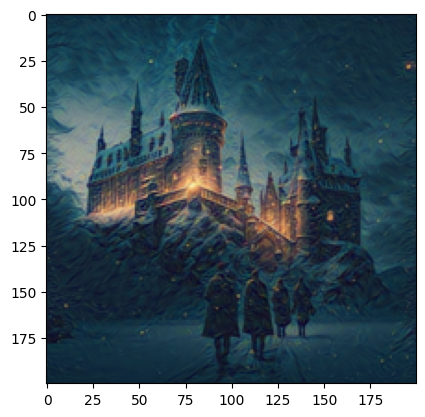

content loss5.587543964385986
style loss1227.099853515625
total loss1232.6873779296875


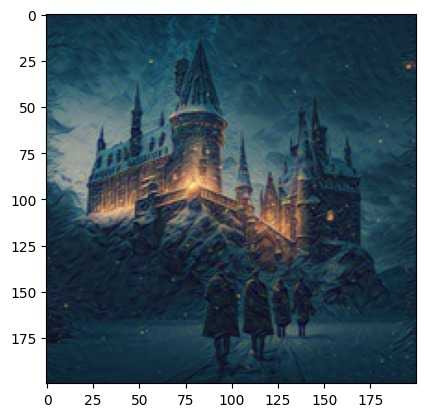

content loss5.860745906829834
style loss1141.178466796875
total loss1147.0391845703125


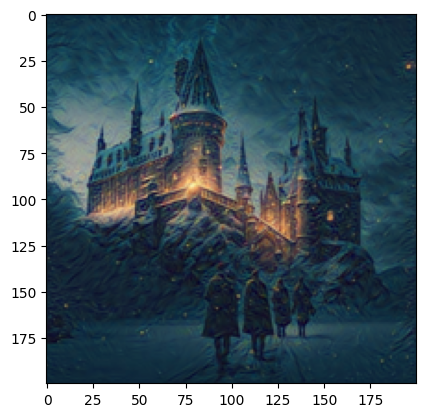

content loss6.119676113128662
style loss1066.754638671875
total loss1072.874267578125


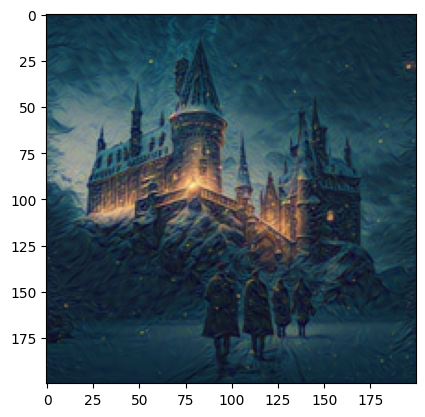

content loss6.359250545501709
style loss1003.1655883789062
total loss1009.5248413085938


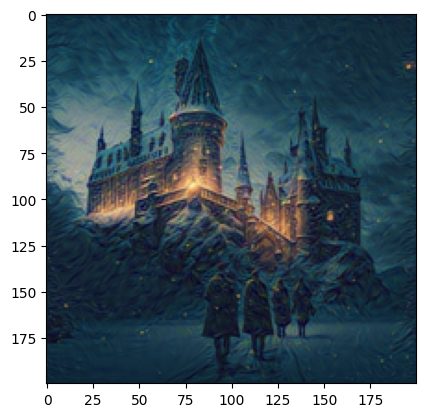

content loss6.586604595184326
style loss946.5586547851562
total loss953.145263671875


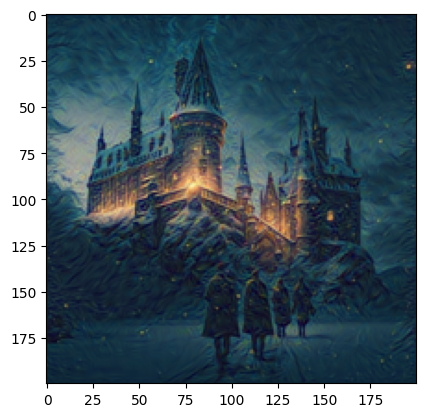

content loss6.8029093742370605
style loss895.0723876953125
total loss901.8753051757812


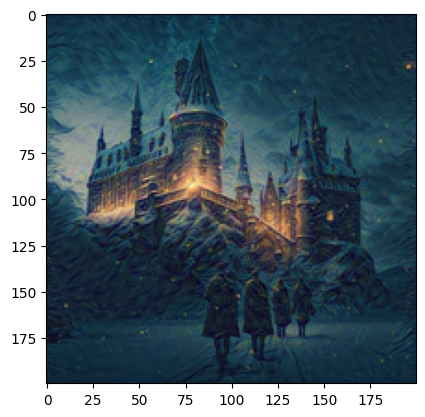

content loss7.015130519866943
style loss846.8440551757812
total loss853.8591918945312


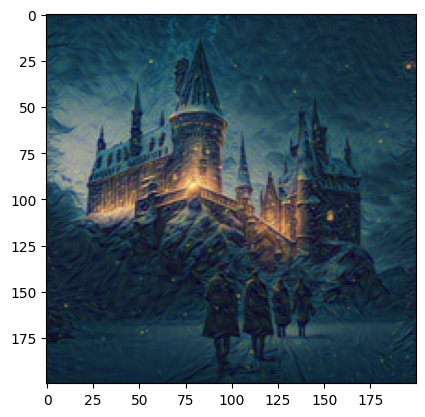

content loss7.2238640785217285
style loss801.2172241210938
total loss808.4411010742188


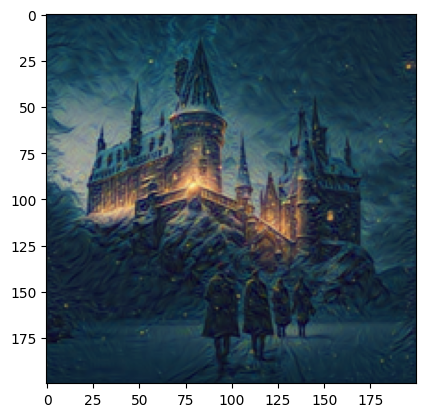

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
content loss9.715739250183105
style loss1.1330705881118774
total loss10.848810195922852


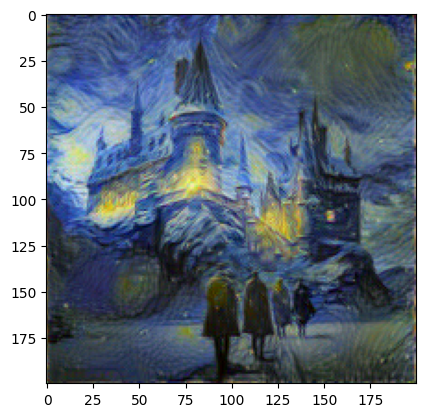

content loss9.714839935302734
style loss1.1325989961624146
total loss10.84743881225586


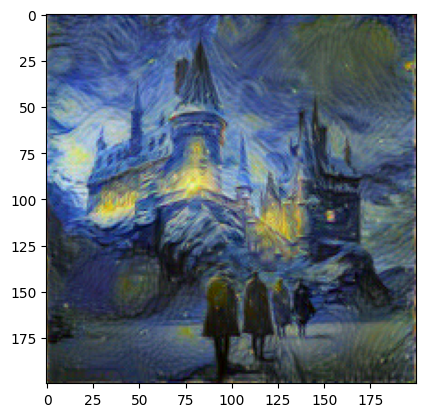

content loss9.713951110839844
style loss1.1319760084152222
total loss10.845927238464355


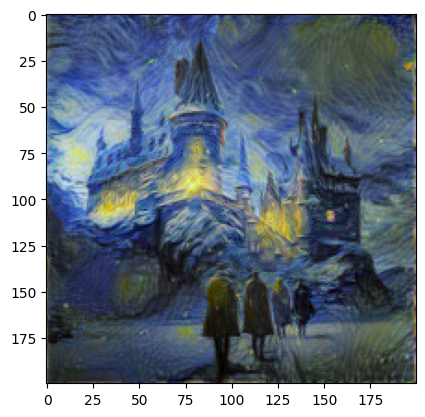

content loss9.713025093078613
style loss1.1314568519592285
total loss10.844482421875


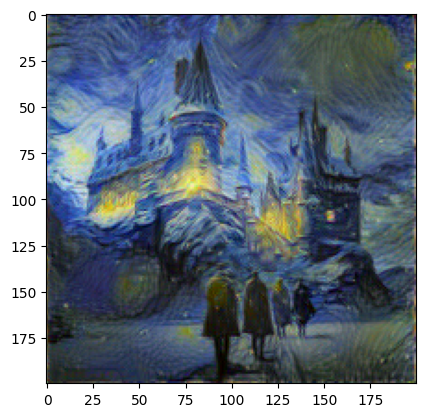

content loss9.712173461914062
style loss1.1309356689453125
total loss10.843109130859375


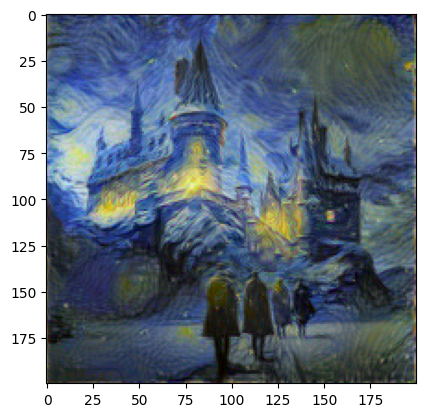

content loss9.711336135864258
style loss1.1304255723953247
total loss10.841761589050293


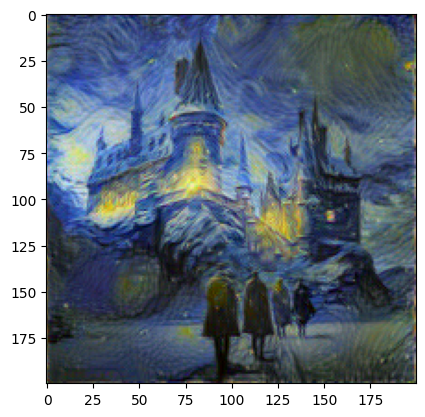

content loss9.71047592163086
style loss1.1298877000808716
total loss10.840363502502441


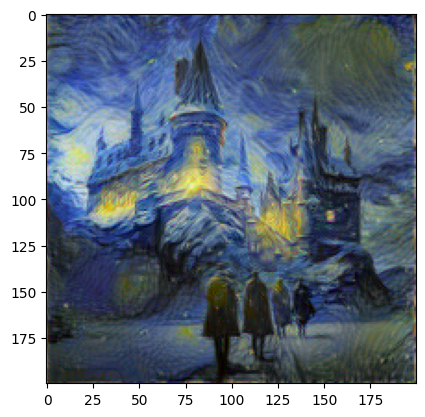

content loss9.70963191986084
style loss1.129357099533081
total loss10.8389892578125


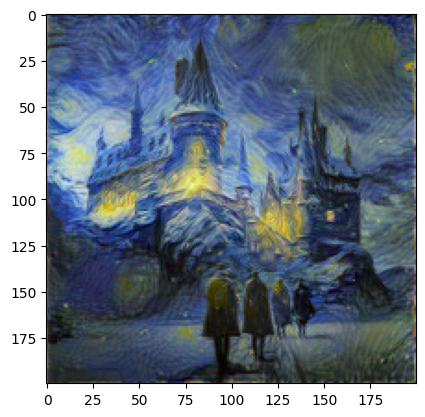

content loss9.708818435668945
style loss1.128907322883606
total loss10.837725639343262


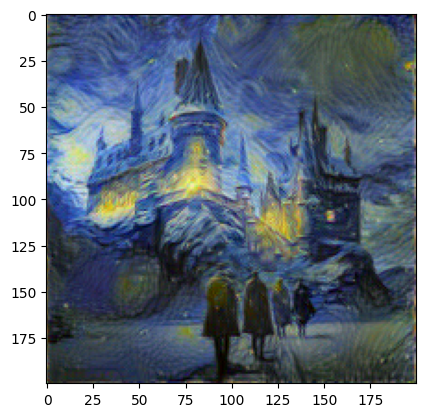

content loss9.70802116394043
style loss1.1282991170883179
total loss10.836319923400879


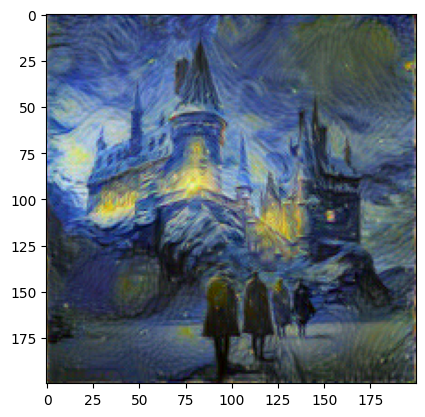

content loss9.707112312316895
style loss1.127826452255249
total loss10.834939002990723


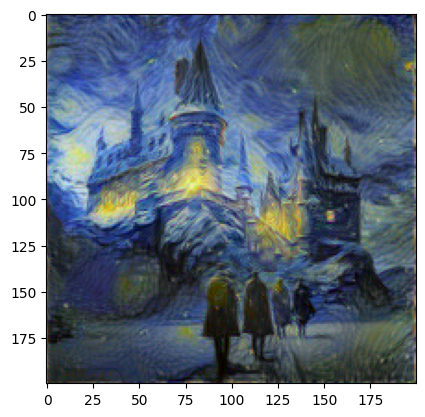

content loss9.70632266998291
style loss1.127354621887207
total loss10.833677291870117


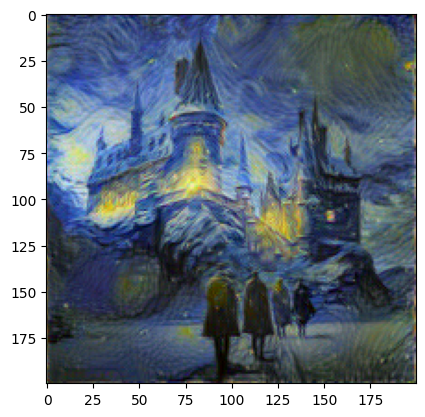

content loss9.705547332763672
style loss1.1267850399017334
total loss10.832332611083984


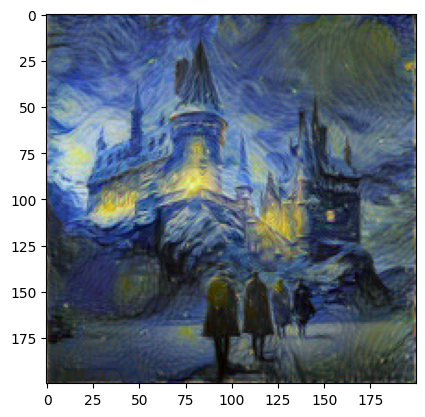

content loss9.70472526550293
style loss1.1262845993041992
total loss10.831009864807129


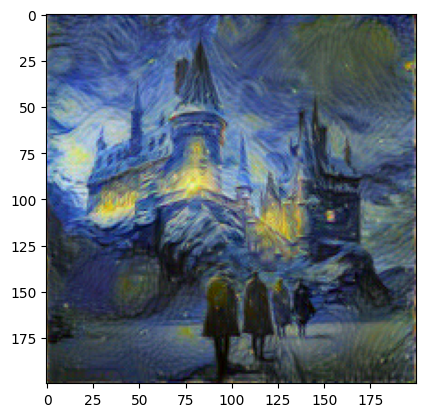

content loss9.703954696655273
style loss1.1256818771362305
total loss10.829636573791504


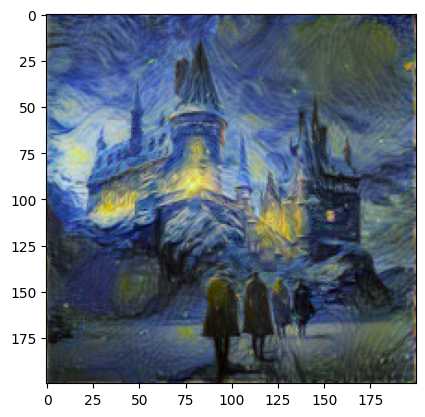

content loss9.70309066772461
style loss1.125169038772583
total loss10.828259468078613


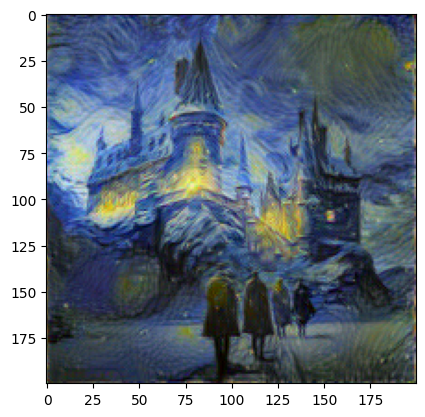

content loss9.702371597290039
style loss1.1247061491012573
total loss10.827077865600586


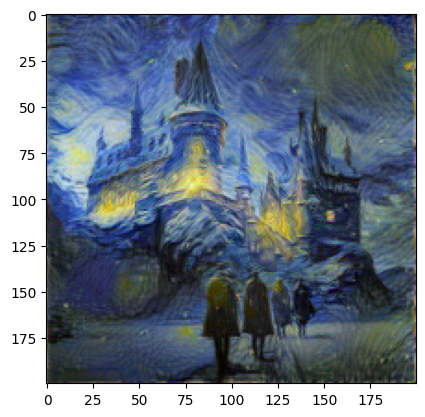

content loss9.701692581176758
style loss1.1240891218185425
total loss10.82578182220459


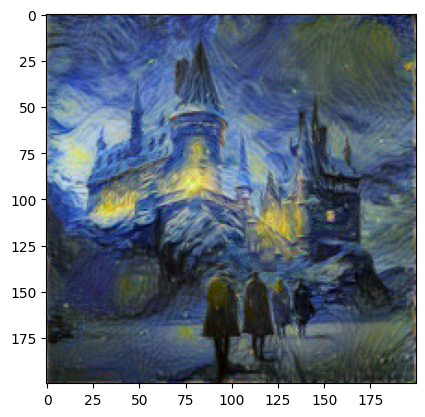

content loss9.700966835021973
style loss1.1236035823822021
total loss10.824570655822754


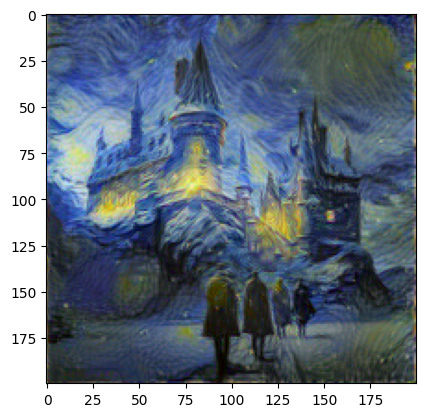

content loss9.700304985046387
style loss1.123044729232788
total loss10.823349952697754


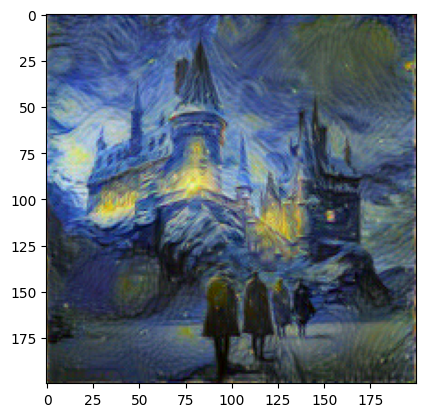

51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
content loss9.518733978271484
style loss1.0095248222351074
total loss10.52825927734375


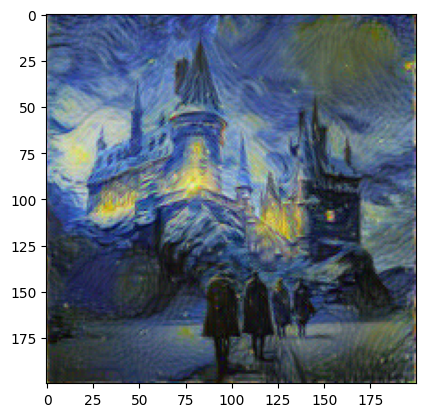

content loss9.516317367553711
style loss1.008097767829895
total loss10.524415016174316


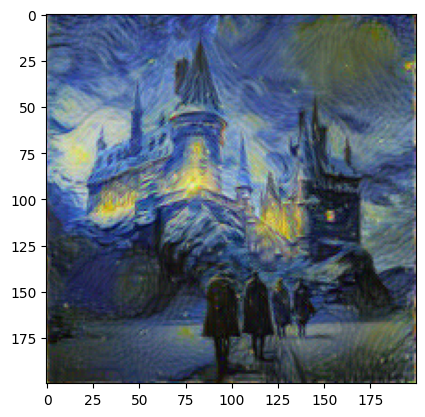

content loss9.51462173461914
style loss1.0063283443450928
total loss10.520950317382812


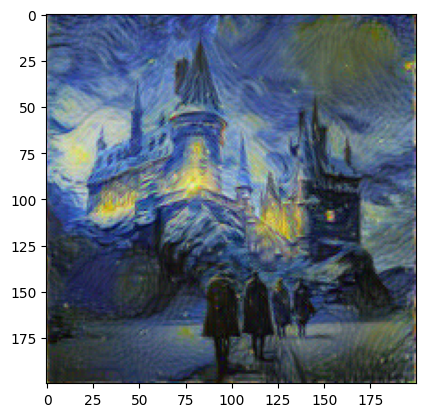

content loss9.512459754943848
style loss1.0052520036697388
total loss10.517711639404297


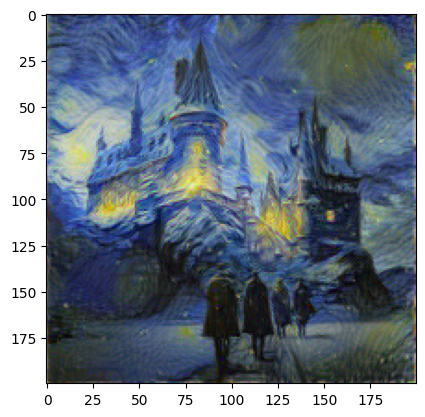

content loss9.510702133178711
style loss1.0034338235855103
total loss10.51413631439209


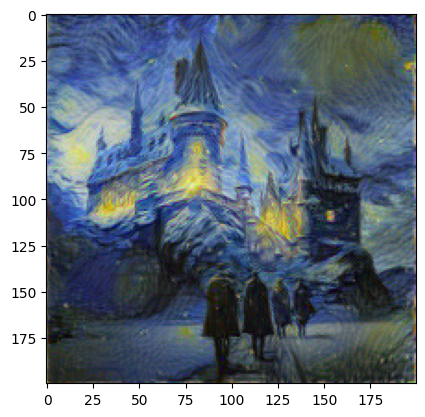

content loss9.508622169494629
style loss1.0022249221801758
total loss10.510847091674805


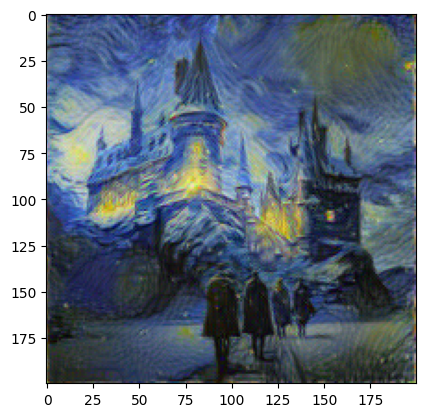

content loss9.506939888000488
style loss1.00056791305542
total loss10.50750732421875


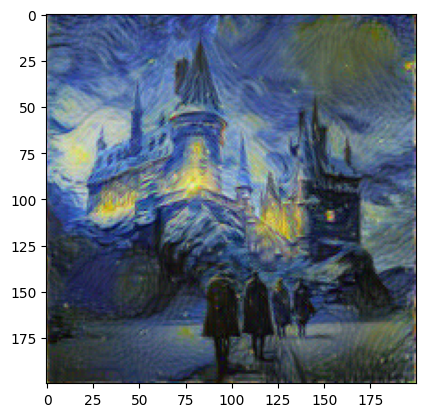

content loss9.50517463684082
style loss0.9991225600242615
total loss10.504297256469727


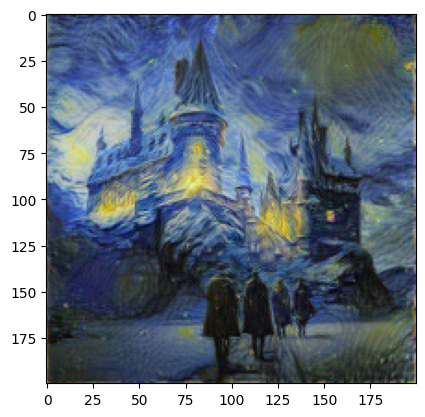

content loss9.503303527832031
style loss0.9974460005760193
total loss10.500749588012695


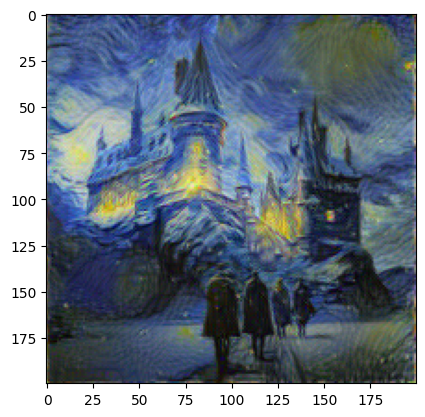

content loss9.501587867736816
style loss0.9958525896072388
total loss10.497440338134766


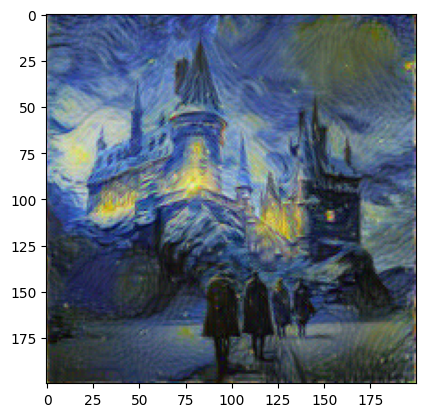

content loss9.499635696411133
style loss0.994256854057312
total loss10.493892669677734


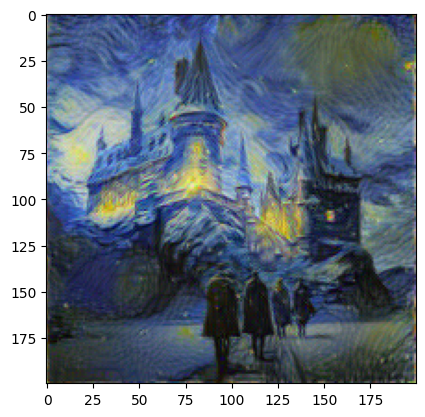

content loss9.498092651367188
style loss0.992530882358551
total loss10.490623474121094


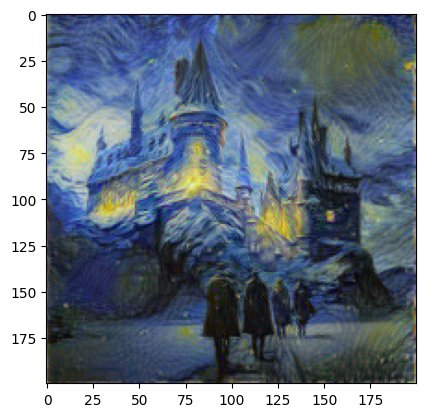

content loss9.49651050567627
style loss0.9912226796150208
total loss10.487732887268066


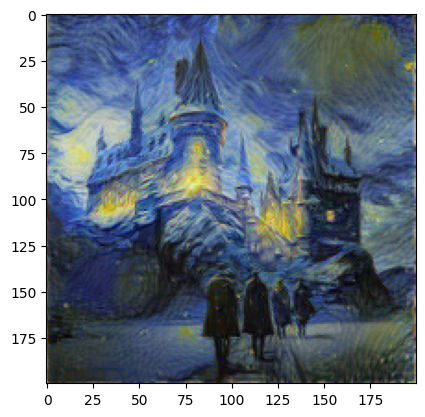

content loss9.49509334564209
style loss0.9894761443138123
total loss10.484569549560547


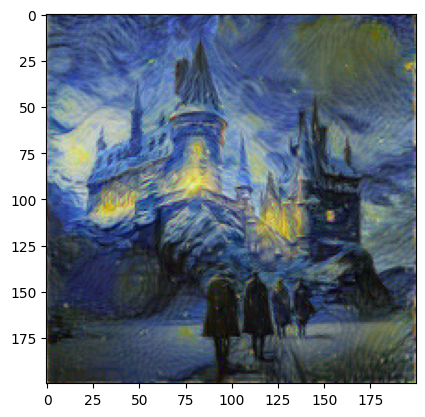

content loss9.49365520477295
style loss0.9882062673568726
total loss10.481861114501953


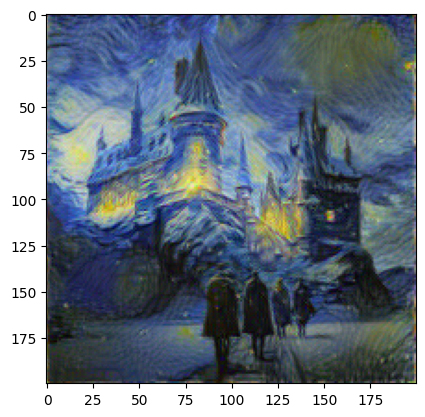

content loss9.492241859436035
style loss0.9867336750030518
total loss10.478975296020508


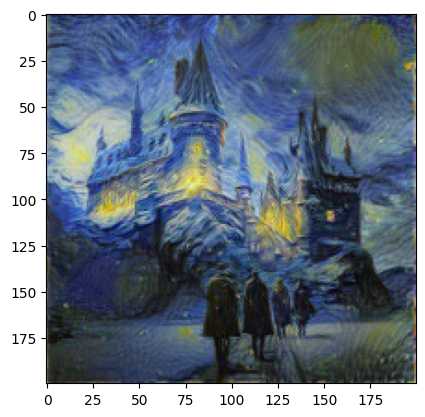

content loss9.490710258483887
style loss0.9853668212890625
total loss10.47607707977295


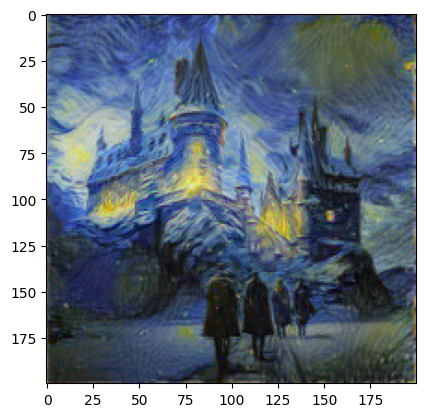

content loss9.489291191101074
style loss0.9841991066932678
total loss10.473490715026855


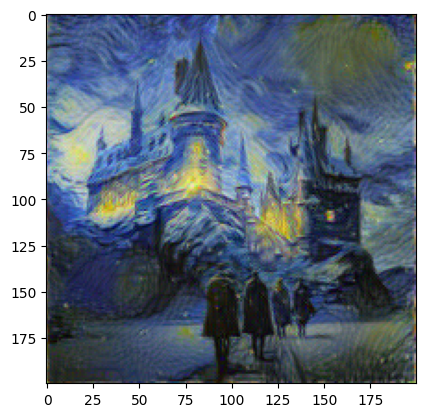

content loss9.487985610961914
style loss0.9830403327941895
total loss10.471025466918945


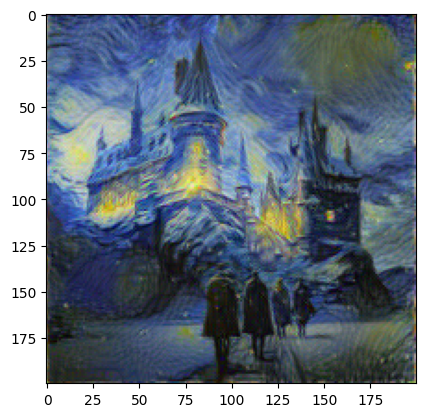

content loss9.486595153808594
style loss0.9819543957710266
total loss10.468549728393555


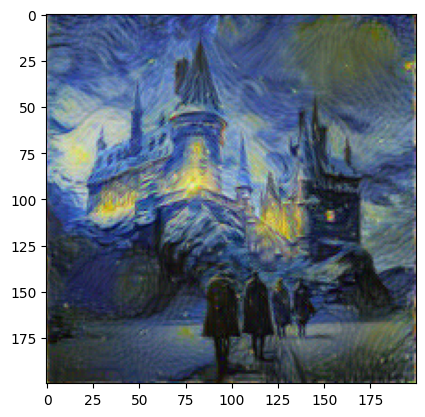

101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
content loss9.336984634399414
style loss0.9207457900047302
total loss10.257730484008789


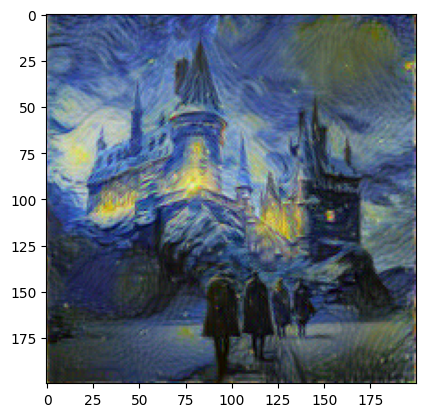

content loss9.336963653564453
style loss0.9207242131233215
total loss10.25768756866455


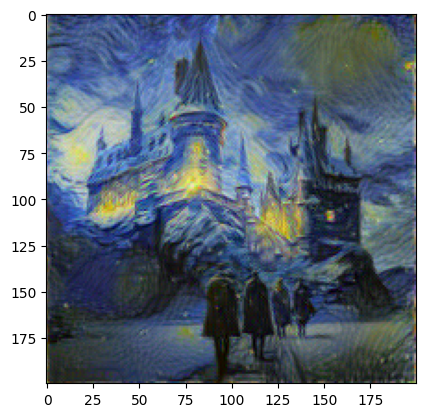

content loss9.336945533752441
style loss0.920689046382904
total loss10.257634162902832


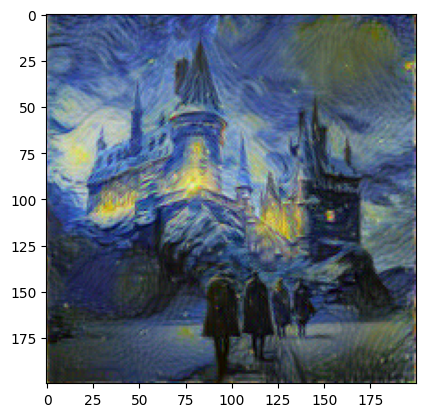

content loss9.336915969848633
style loss0.9206753373146057
total loss10.257591247558594


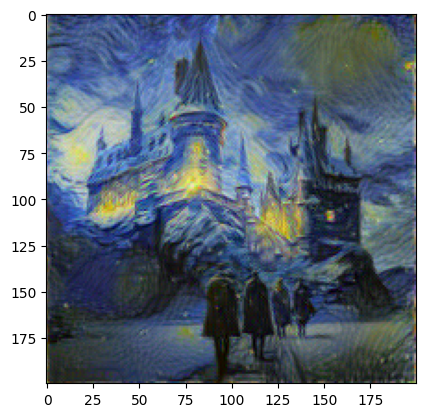

content loss9.336945533752441
style loss0.920689046382904
total loss10.257634162902832


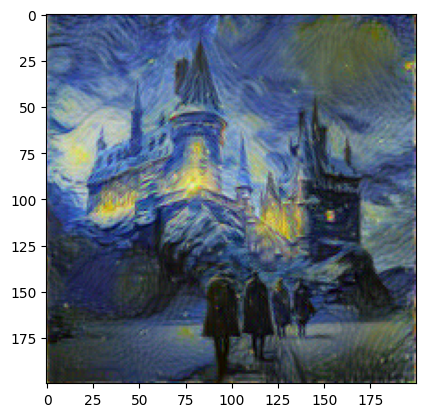

content loss9.336915969848633
style loss0.9206753373146057
total loss10.257591247558594


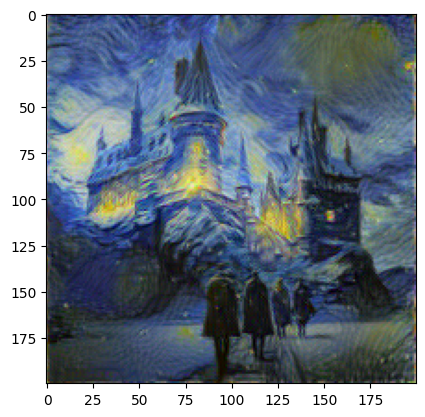

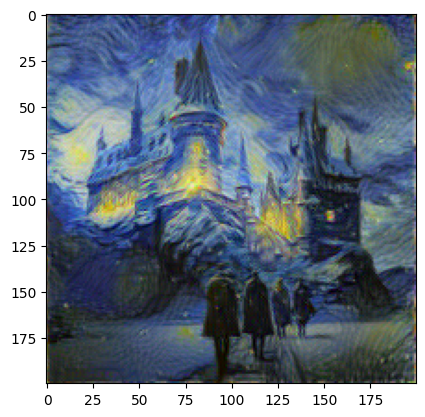

content loss9.336901664733887
style loss0.9206480383872986
total loss10.257549285888672
content loss9.336901664733887
style loss0.9206480383872986
total loss10.257549285888672


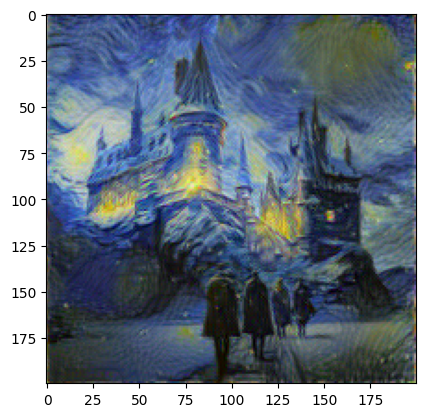

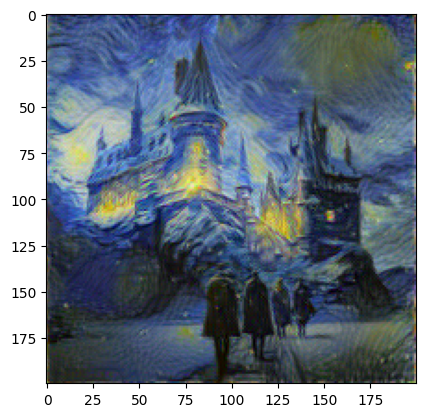

content loss9.336884498596191
style loss0.9206197261810303
total loss10.2575044631958
content loss9.336884498596191
style loss0.9206197261810303
total loss10.2575044631958


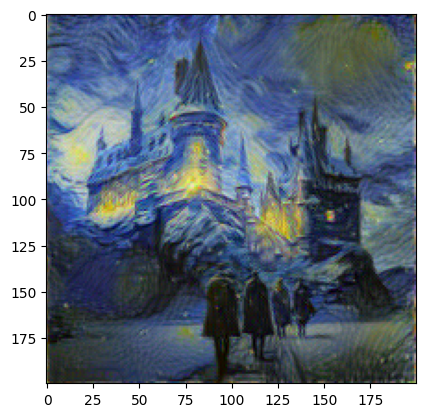

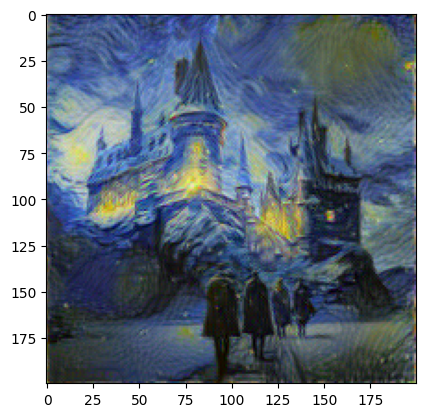

content loss9.336868286132812
style loss0.9205888509750366
total loss10.25745677947998
content loss9.336868286132812
style loss0.9205888509750366
total loss10.25745677947998


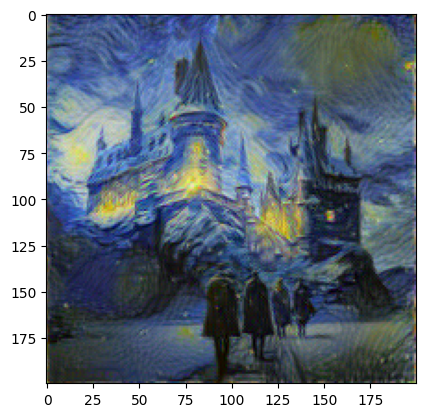

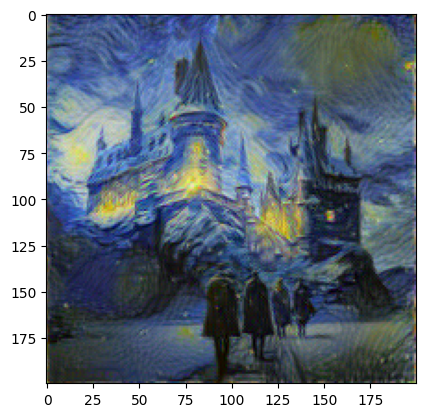

content loss9.336848258972168
style loss0.9205664992332458
total loss10.257414817810059
content loss9.336848258972168
style loss0.9205664992332458
total loss10.257414817810059


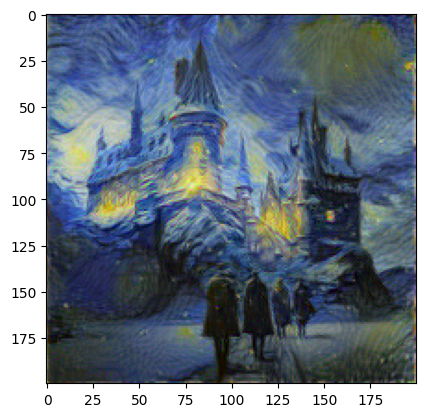

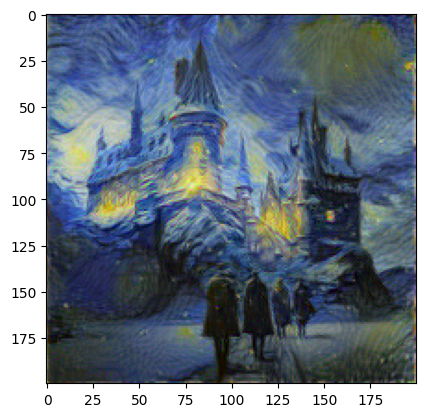

content loss9.336833953857422
style loss0.9205374121665955
total loss10.257370948791504
content loss9.336833953857422
style loss0.9205374121665955
total loss10.257370948791504


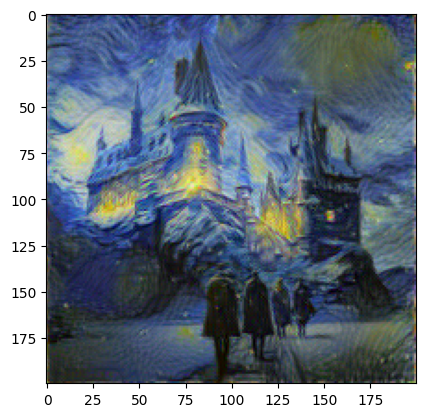

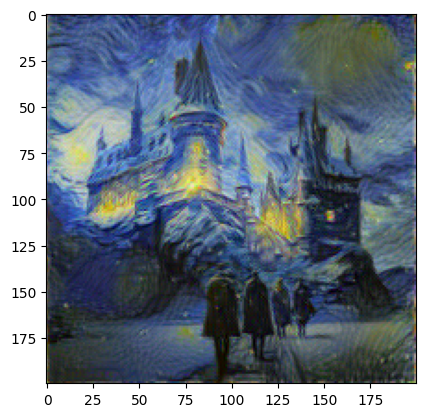

content loss9.336816787719727
style loss0.9205119609832764
total loss10.257328987121582
content loss9.336816787719727
style loss0.9205119609832764
total loss10.257328987121582


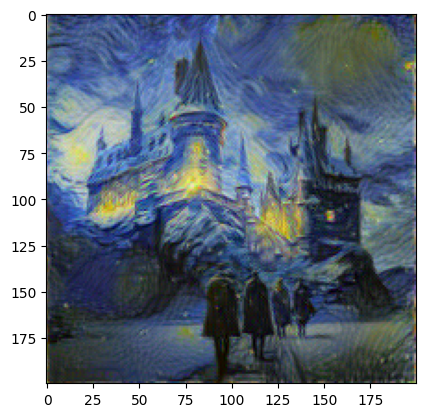

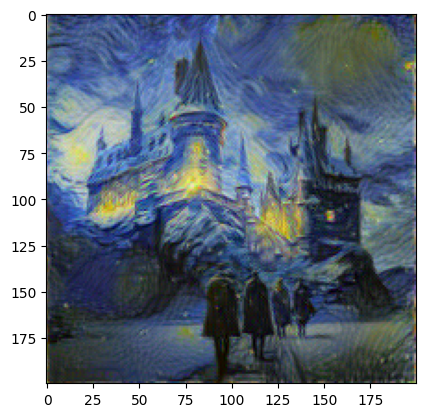

content loss9.33680248260498
style loss0.9204810857772827
total loss10.257283210754395
content loss9.33680248260498
style loss0.9204810857772827
total loss10.257283210754395


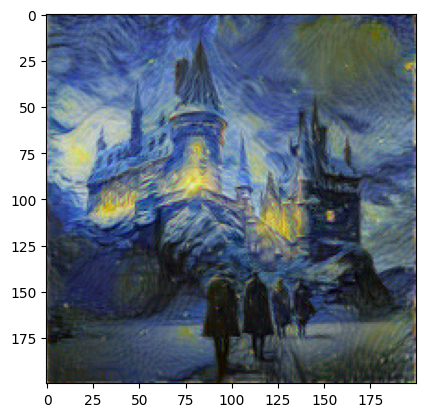

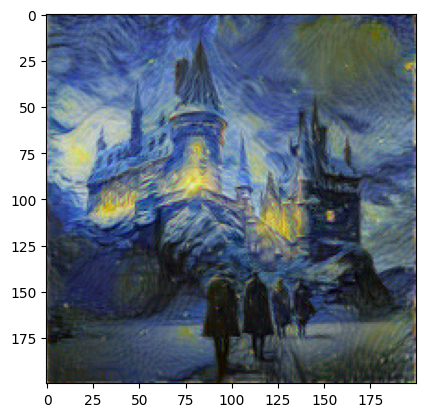

content loss9.336786270141602
style loss0.9204508066177368
total loss10.257237434387207
content loss9.336786270141602
style loss0.9204508066177368
total loss10.257237434387207


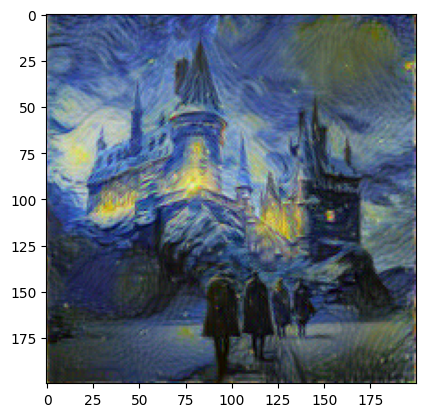

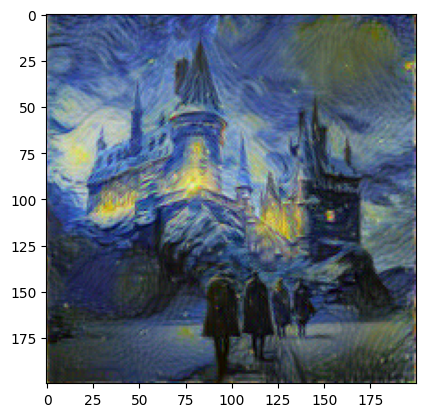

content loss9.336767196655273
style loss0.9204263687133789
total loss10.257193565368652
content loss9.336767196655273
style loss0.9204263687133789
total loss10.257193565368652


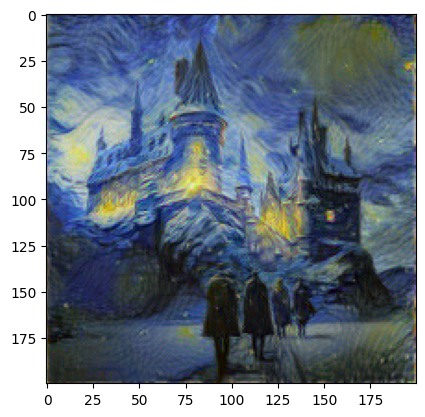

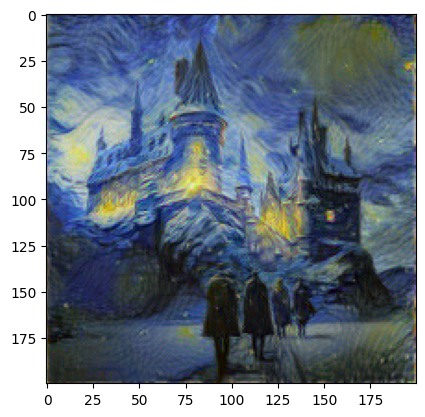

content loss9.336750030517578
style loss0.9203951954841614
total loss10.257144927978516
content loss9.336750030517578
style loss0.9203951954841614
total loss10.257144927978516


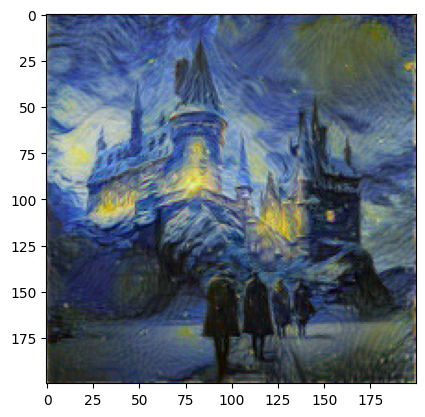

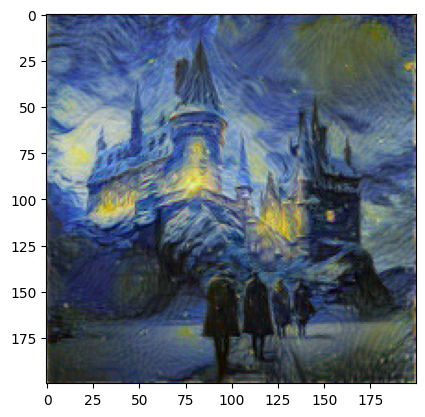

content loss9.336725234985352
style loss0.9203746914863586
total loss10.257100105285645
content loss9.336725234985352
style loss0.9203746914863586
total loss10.257100105285645


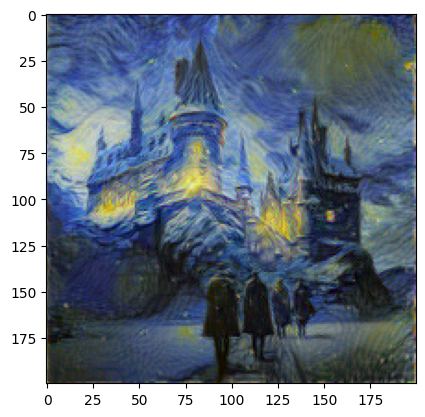

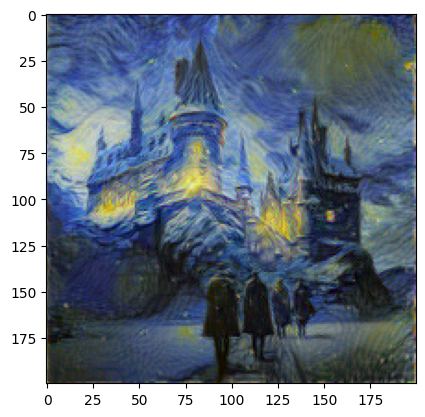

content loss9.33670425415039
style loss0.920346736907959
total loss10.257051467895508
content loss9.33670425415039
style loss0.920346736907959
total loss10.257051467895508


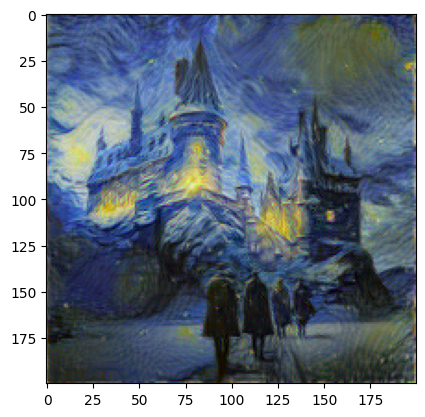

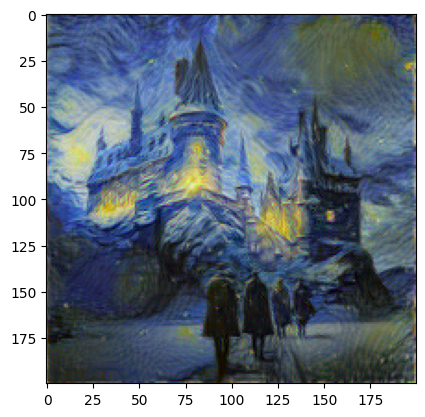

content loss9.336674690246582
style loss0.9203299880027771
total loss10.257004737854004
content loss9.336674690246582
style loss0.9203299880027771
total loss10.257004737854004


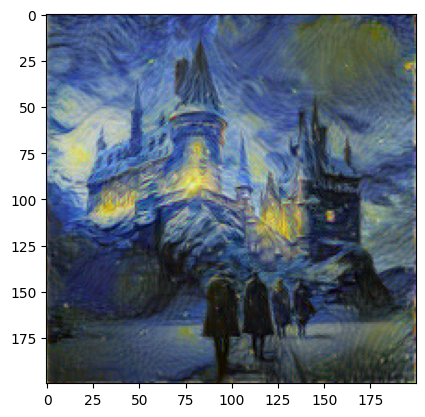

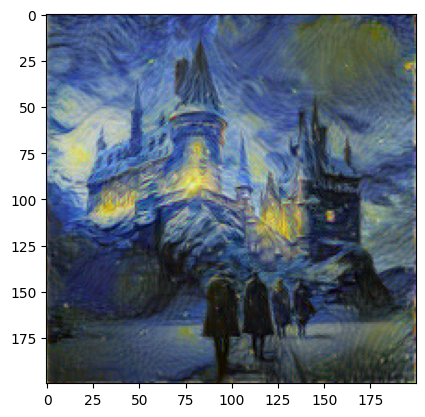

content loss9.336651802062988
style loss0.9203073978424072
total loss10.256958961486816
content loss9.336651802062988
style loss0.9203073978424072
total loss10.256958961486816


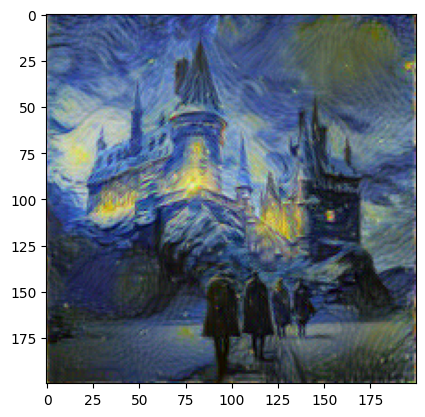

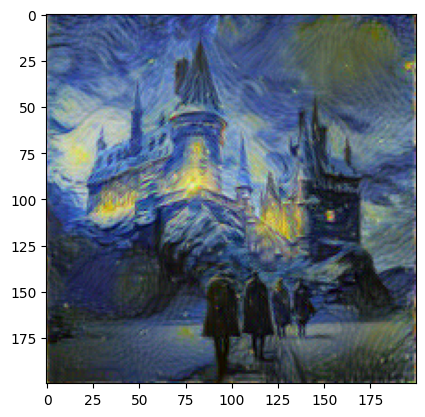

content loss9.336625099182129
style loss0.9202843904495239
total loss10.256909370422363
content loss9.336625099182129
style loss0.9202843904495239
total loss10.256909370422363


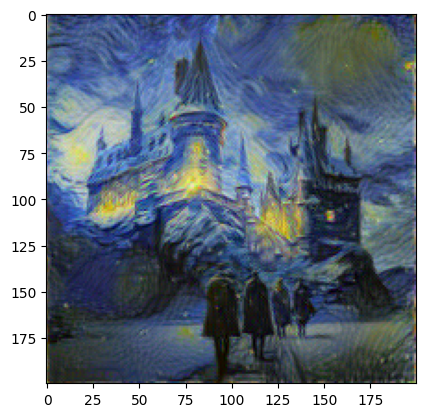

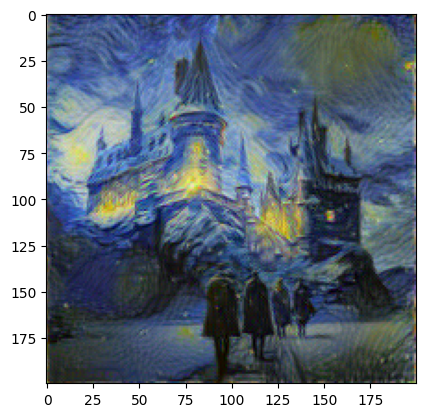

content loss9.33659553527832
style loss0.9202685952186584
total loss10.256864547729492
content loss9.33659553527832
style loss0.9202685952186584
total loss10.256864547729492


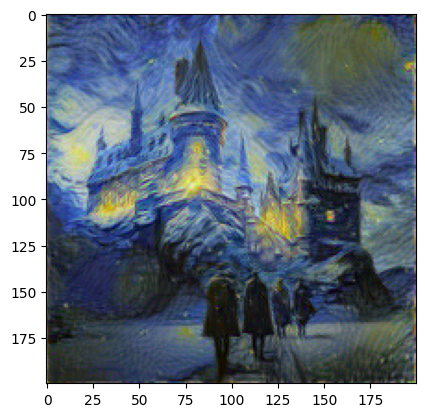

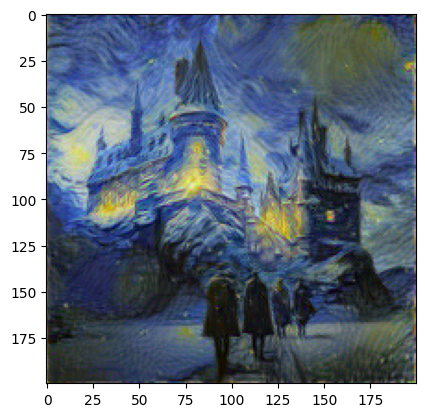

In [35]:
# Train your model using LBFGS optimizer and 2 implemented losses (style loss and content loss)
# You should report the `style loss`, `content loss`, and `total loss` for each iteration. Note that `total loss`
# is the sum of `style loss` and `content loss` with some weights (alpha and beta) which you should tune them.
# Also, please plot the image each 50 iterations.
# An important note is that your optimizer might change the values of the image tensor in a way that the pixel values
# are no longer in the range of [0, 1] (in normalized format). So, you should clip the values of the image tensor
# to be in the range of [0, 1] after each iteration, to prevent any problems occuring to your image.
# TODO
alpha = 1.0
beta = 1e6
input_image = content_img.clone().requires_grad_(True)
optimizer = optim.LBFGS([input_image], lr=0.1)
num_steps = 151
total_losses_values = []
style_losses_values = []
content_losses_values = []
for step in range(num_steps):
    print(step)
    def closure():
        model(input_image)
        optimizer.zero_grad()
        style_score = 0
        content_score = 0
        for sloss in style_losses:
            style_score += sloss.loss
        for closs in content_losses:
            content_score += closs.loss
        style_score *= beta
        content_score *= alpha
        loss = content_score + style_score
        loss.backward()
        with torch.no_grad():
            input_image.clamp_(0, 1)
        content_losses_values.append(content_score.item())
        style_losses_values.append(style_score.item())
        total_losses_values.append(loss.item())
        if step % 50 == 0:
            print("content loss" + str(content_score.item()))
            print("style loss" + str(style_score.item()))
            print("total loss" + str(loss.item()))
            plt.figure()
            imshow(input_image)
            plt.show()
        return loss

    optimizer.step(closure)

Now, let's see the result of optimization process on our `input_image`.

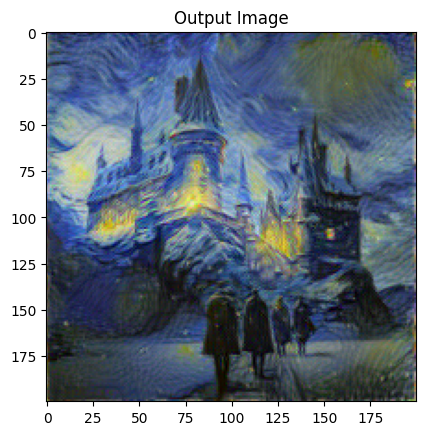

In [36]:
plt.figure()
imshow(input_image, title='Output Image')
plt.show()

(5/90 pts) Also, let's plot our `style_losses`, `content_losses` and `total_losses` to see how they change during the optimization process.

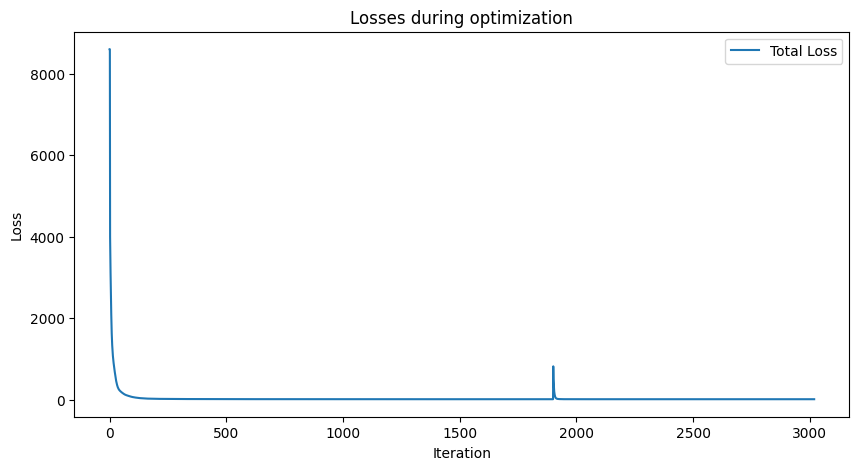

In [37]:
plt.figure(figsize=(10, 5))
plt.plot(total_losses_values, label='Total Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()
plt.title('Losses during optimization')
plt.show()

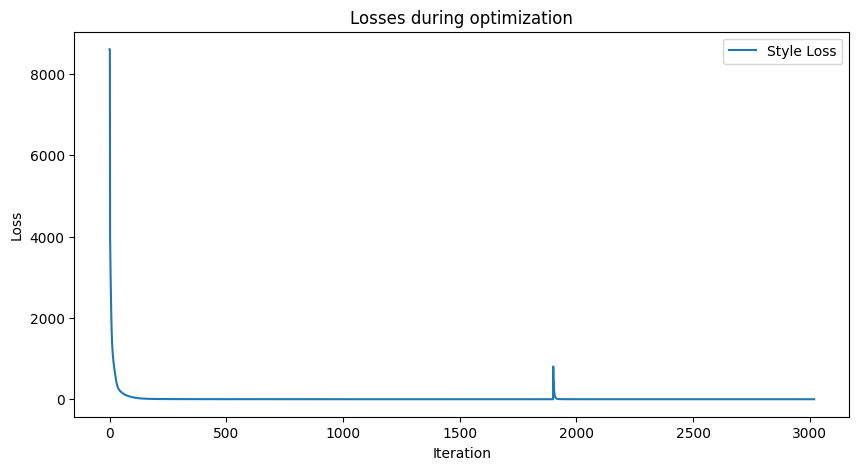

In [38]:
# TODO: Plot the style loss w.r.t. the iteration number
plt.figure(figsize=(10, 5))
plt.plot(style_losses_values, label='Style Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()
plt.title('Losses during optimization')
plt.show()


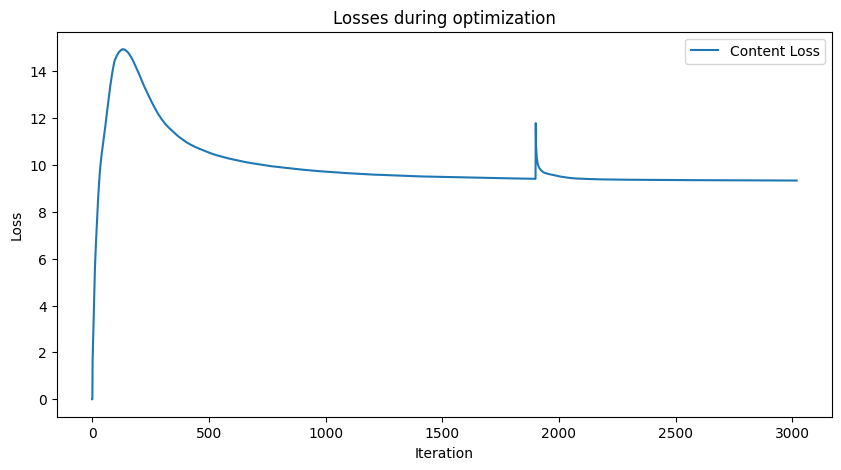

In [39]:
# TODO: Plot the content loss w.r.t. the iteration number
plt.figure(figsize=(10, 5))
plt.plot(content_losses_values, label='Content Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()
plt.title('Losses during optimization')
plt.show()